<a href="https://colab.research.google.com/github/MagMueller/Solar-Potential-Analysis-using-Semi-Supervised-Image-Segmentation/blob/main/TensorflowModelSemiSupervisedImageSegmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [ ]:
#!pip install --upgrade tensorflow_addons

     |████████████████████████████████| 1.1 MB 4.5 MB/s 


In [ ]:
#!!pip install tensorflow_addons

In [ ]:
import json
import os
import pdb
import random
import re
import sys
import datetime
import cv2
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import tensorflow.nn as nn
import tensorflow_addons as tfa
from google.colab.patches import cv2_imshow
from PIL import Image, ImageDraw
from tensorflow import keras
from tensorflow.keras import Input, Model, layers
from tensorflow.keras.utils import plot_model

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
visualize = 1
epochs = 100  # number of maximum iterations
minLabels = 1

# data
folder = "drive/MyDrive/data"  # input folder
#n_samples = 10

# model
nConv = 4  # for Model
my_batch_size = 1
nChannel = 40  # for Model

# learning
lr = 1e-5
stepsize_sim = 1
stepsize_con = 1.5
stepsize_mask = 0.5
new_loss_function = True


pretraining = False
n_epochs_pretraining = 1

skip_images = True
skip_small_images_threshold = 0.15 # if roof fill less than threshold, skip image 
skip_large_images_threshold = 0.9 # if roof fill more than threshold, skip image 

max_files_per_epoch = 10
number_of_files_in_batch = (
    2  # will be divided by 2 to get the number of images in batch
)



In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


Check data for equality

In [ ]:
num_max_passes = int((len(os.listdir(folder)) / number_of_files_in_batch))

# import modules
import glob
import json
import os
import sys

# define variables
json_files = glob.glob("folder/*.json")
png_files = glob.glob("folder/*.png")

# check if equal number of json and png files
if len(json_files) == len(png_files):
    print("OK")
else:
    print("ERROR")
    sys.exit(1)

# check if every png file has a corresponding json file
for png in png_files:
    png_name = png.split("/")[-1]
    png_name = png_name.split(".")[0]
    if png_name + ".json" not in json_files:
        print("ERROR")
        sys.exit(1)
    else:
        print("OK")


OK


# Data loading and Preprocessing

In [ ]:

def transform(n):
  return 256-int(n * 10)

def extract_mask(file):
  if not file.endswith(".json"):
    raise ValueError('File has to end with .json')
  with open(folder+"/"+file) as json_file:
    data = json.load(json_file)
    #print(data)
    bbox = re.search(r'\"crs\": \"EPSG:25832\", \"bbox\": \[(.*?)\]', data)
    coordinates_bbx = re.findall(r'\[(.*?)\]', bbox.group(0))
    coordinates_bbx = [float(x) for x in coordinates_bbx[0].split(',')]

    geometry = re.search(r'\"geometry\": {\"type\": \"Polygon\", \"coordinates\": \[\[\[(.*?)\]\]\]', data)

    coordinates = re.findall(r'\[(.*?)\]', geometry.group(0))
    coordinates[0] = coordinates[0][2:]
    # convert 'pair,pair', 'pair,pair' to [[x,y],[x,y]]
    coordinates = [x.split(',') for x in coordinates]
    # for each pair in coordinates, convert to float
    if coordinates.count('[') != coordinates.count(']'):
      raise ValueError('Not balanced!')
    try:
      coordinates = [[float(x) for x in y] for y in coordinates]
    except ValueError:
        print('Skipped some mask!')
        return
    # for each pair in coordinates, subtract bbox
    coordinates = [[coordinates_bbx[2]-x[0], x[1]-coordinates_bbx[1]] for x in coordinates]
    #coordinates = [[x[0]-coordinates_bbx[0], x[1]-coordinates_bbx[1]] for x in coordinates]
    #masks_coor[file.split(".")[0]] = coordinates
    coordinates = [list(map(transform,x)) for x in coordinates]

    polygon = [tuple(l) for l in coordinates]

    width = 256
    height = 256

    mask_img = Image.new('L', (width, height), 0)
    ImageDraw.Draw(mask_img).polygon(polygon, outline=1, fill=1)
    mask_poly = np.array(mask_img)
    return mask_poly
  

In [ ]:
def load_images_from_folder_multiple(folder=folder):
  """
    load images from folder file path
  """
  if not (number_of_files_in_batch / 2).is_integer():
    raise ValueError('Number of files in batch must be a multiple of 2')
  files = sorted(os.listdir(folder))

  files_large_roofs = []
  # skip all images with small roof
  print(f'len(files): {len(files)}')
  total_size = 256 * 256

  if skip_images:
    for f in range(0,len(files),2):
      # if right combination:
      if files[f+1].split(".")[0] == files[f].split(".")[0]:
        if files[f+1].endswith('.json'):
          mask = extract_mask(files[f+1])
          if mask is None:
            continue
          #print(type(mask))
          #total_size = len(mask.flatten())
          #print(f'total_size: {total_size}')
          roof_size = mask.sum()
          #print(f'roof_size: {roof_size}')
          percentage_of_roof = roof_size / total_size
          #print(f'percentage_of_roof: {percentage_of_roof}')
          if percentage_of_roof > skip_small_images_threshold and percentage_of_roof < skip_large_images_threshold:
            files_large_roofs.append(files[f])
            files_large_roofs.append(files[f+1])
        else:
          print('Error Json')
          continue
      else:
        print('Not same file')
        continue

    files_large_roofs = sorted(files_large_roofs)
    print(f'len(files_large_roofs): {len(files_large_roofs)}')
    files = files_large_roofs

  for i in range(0, len(files), number_of_files_in_batch):
    # get the batch
    batch = files[i:i + number_of_files_in_batch]
    images = []
    masks = []
    # for each image and mask in batch read it and append it to the list
    for data in batch:
      mask = []
      if data.endswith('.PNG'):
        img = cv2.imread(os.path.join(folder,data))
        images.append(img)
      if data.endswith('.json'):
        mask = extract_mask(data)
        masks.append(mask)  

 
    # check if everything goes right, and we have a mask and a image
    if (len(images) > (number_of_files_in_batch / 2)) or (len(masks) > (number_of_files_in_batch / 2)):
      print("unbalanced")
      continue
    if any(elem is None for elem in masks):
      print("Mask was none, skipping image")
      continue
    yield images, masks

len(files): 750
Skipped some mask!
Skipped some mask!
len(files_large_roofs): 288


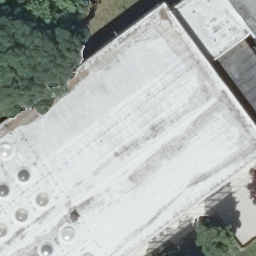

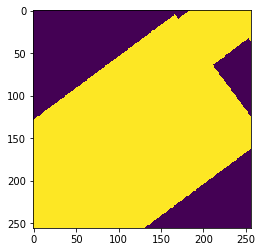

In [ ]:
# TEST GENERATOR
test_gen = load_images_from_folder_multiple(folder)
next(test_gen)
next(test_gen)

k1,k2 = next(test_gen)

cv2_imshow(k1[0])

from matplotlib import pyplot as plt
plt.imshow(k2[0], interpolation='nearest')
plt.show()



len(files): 750
Skipped some mask!
Skipped some mask!
len(files_large_roofs): 288


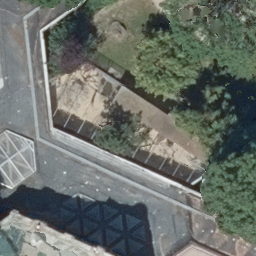

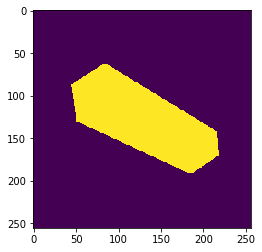

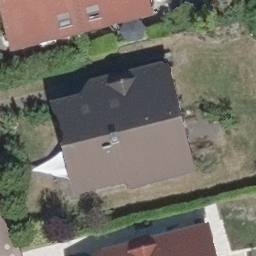

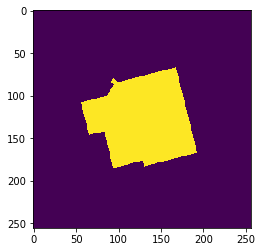

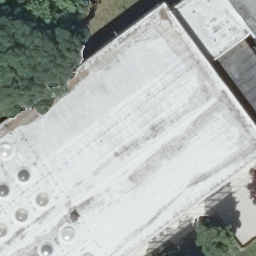

...

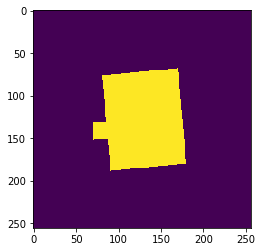

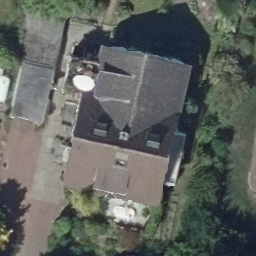

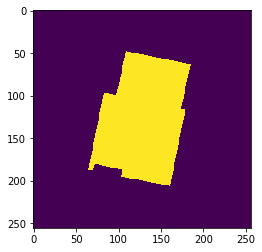

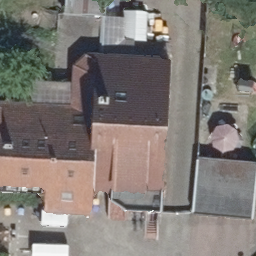

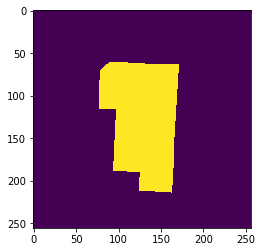

In [41]:
#dataset_raw = tf.data.Dataset.from_generator(load_images_from_folder_multiple,output_types=(tf.float32, tf.float32), output_shapes = ((1, 256, 256, 3),(1, 256, 256)))
dataset_raw = tf.data.Dataset.from_generator(load_images_from_folder_multiple,output_types=(tf.float32, tf.float32))#, output_shapes = ((1, 256, 256, 3),(1, 256, 256)))
dataset_preview = tf.data.Dataset.from_generator(load_images_from_folder_multiple,output_types=(tf.float32, tf.float32), output_shapes = ((1, 256, 256, 3),(1, 256, 256)))

# test if dataset is correctly initialized, but not with the actual genarator
img = 0
for image, masks in dataset_preview.take(16):
    numpy_images = image.numpy()
    cv2_imshow(numpy_images.squeeze())
    img = numpy_images.squeeze()
    numpy_labels = masks.numpy()
    plt.imshow(numpy_labels.squeeze(), interpolation='nearest')
    plt.show()



In [ ]:
# data pipeline
def prepare_data(data):
  """
  Perfom preprocessing steps on the tensorflow dataset

  """
  #data = data.map(lambda sample, target: (tf.squeeze(sample),tf.squeeze(target)))
  data = data.map(lambda sample, target: (tf.cast(sample, 'float32')/255., target))
  #data = data.map(lambda sample: (tf.transpose(sample,(2,0,1)))) #channel first

  # cache this progress in memory, as there is no need to redo it; it is deterministic after all
  data = data.cache()

  # shuffle, batch, prefetch
  data = data.shuffle(1000)
  data = data.batch(my_batch_size)
  #data = data.prefetch(10)

  # return preprocessed dataset
  return data


In [ ]:
# data pipeline
def prepare_data_without_shuffle(data):
  """
  Perfom preprocessing steps on the tensorflow dataset

  """
  #data = data.map(lambda sample, target: (tf.squeeze(sample),tf.squeeze(target)))
  data = data.map(lambda sample, target: (tf.cast(sample, 'float32')/255., target))
  #data = data.map(lambda sample: (tf.transpose(sample,(2,0,1)))) #channel first

  # cache this progress in memory, as there is no need to redo it; it is deterministic after all
  data = data.cache()

  # shuffle, batch, prefetch
  data = data.batch(my_batch_size)
  #data = data.prefetch(10)

  # return preprocessed dataset
  return data


In [ ]:
dataset = dataset_raw.apply(prepare_data)

# Model


In [96]:
# input_shape = (my_batch_size, nChannel, 256, 256)
# CNN model
class UnsupervisedImageClustering(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClustering, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.pooling = []
        for i in range(nConv):
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            self.pooling.append(
                tf.keras.layers.MaxPooling2D(
                    pool_size=(2, 2), strides=(1, 1), padding="same"
                )
            )
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        for i in range(nConv):
            x = self.conv2[i](x)
            x = self.bn2[i](x)
            x = self.pooling[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x


class UnsupervisedImageClusteringNoPooling(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringNoPooling, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.pooling = []
        for i in range(nConv):
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            # self.pooling.append(tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(1, 1), padding='same'))
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        for i in range(nConv):
            x = self.conv2[i](x)
            x = self.bn2[i](x)
            # x = self.pooling[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x


class UnsupervisedImageClusteringBatchNorm(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringBatchNorm, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.pooling = []
        for i in range(nConv):
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            # self.pooling.append(tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(1, 1), padding='same'))
            self.bn2.append(tf.keras.layers.BatchNormalization(axis=-1, momentum=0.015))

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.015)

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        for i in range(nConv):
            x = self.conv2[i](x)
            x = self.bn2[i](x)
            # x = self.pooling[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x


# input_shape = (my_batch_size, nChannel, 256, 256)
# CNN model
class UnsupervisedImageClusteringOwnAvg(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringOwnAvg, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.pooling = []
        for i in range(nConv):
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            self.pooling.append(
                tf.keras.layers.AveragePooling2D(
                    pool_size=(2, 2), strides=(1, 1), padding="same"
                )
            )
            # avg pooling => clustering besser, wobei er die klassen nicht so gut zuordnen kann
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        for i in range(nConv):
            x = self.conv2[i](x)
            x = self.bn2[i](x)
            x = self.pooling[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x


# input_shape = (my_batch_size, nChannel, 256, 256)
# CNN model
class UnsupervisedImageClusteringAddition_1(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringAddition_1, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.conv2skip = []
        self.bn2skip = []
        self.poolingskip = []
        self.pooling = []
        for i in range(nConv):
            # funktioniert erstaunlich gut - lmao
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            self.pooling.append(
                tf.keras.layers.MaxPooling2D(
                    pool_size=(2, 2), strides=(1, 1), padding="same"
                )
            )

            # avg pooling => clustering besser, wobei er die klassen nicht so gut zuordnen kann
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )

        self.conv2skip.append(
            tf.keras.layers.Conv2D(
                nChannel,
                kernel_size=(3, 3),
                strides=1,
                padding="same",
                activation="relu",
            )
        )  # removes variance between classes more pooling
        self.poolingskip.append(
            tf.keras.layers.MaxPool2D(pool_size=(2, 2), strides=(1, 1), padding="same")
        )  # global avg bessere unterscheibung, max aber bessere glättung dafür weniger gute unterscheidung
        self.bn2skip.append(
            tfa.layers.InstanceNormalization(
                axis=3,
                center=True,
                scale=True,
                beta_initializer="random_uniform",
                gamma_initializer="random_uniform",
            )
        )

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        y = self.conv2skip[0](x)
        y = self.poolingskip[0](y)
        y = self.bn2skip[0](y)

        for i in range(nConv):
            if i <= 2:
                x = self.conv2[i](x)
                x = self.bn2[i](x)
                x = self.pooling[i](x)
            if i == 3:
                x = tf.keras.layers.concatenate([x, y])
                x = self.conv2[i](x)
                x = self.bn2[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x


class UnsupervisedImageClusteringWithAdditions(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringWithAdditions, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.conv2skip = []
        self.bn2skip = []
        self.poolingskip = []
        self.pooling = []

        for i in range(nConv):
            # funktioniert erstaunlich gut - lmao
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            self.pooling.append(
                tf.keras.layers.MaxPooling2D(
                    pool_size=(2, 2), strides=(1, 1), padding="same"
                )
            )

            # avg pooling => clustering besser, wobei er die klassen nicht so gut zuordnen kann
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )
            # self.bn2.append(tf.keras.layers.BatchNormalization())

        self.conv2skip.append(
            tf.keras.layers.Conv2D(
                nChannel,
                kernel_size=(3, 3),
                strides=1,
                padding="same",
                activation="relu",
            )
        )  # removes variance between classes more pooling
        self.poolingskip.append(
            tf.keras.layers.MaxPool2D(pool_size=(2, 2), strides=(1, 1), padding="same")
        )  # global avg bessere unterscheibung, max aber bessere glättung dafür weniger gute unterscheidung
        self.bn2skip.append(
            tfa.layers.InstanceNormalization(
                axis=3,
                center=True,
                scale=True,
                beta_initializer="random_uniform",
                gamma_initializer="random_uniform",
            )
        )
        # self.bn2skip.append(tf.keras.layers.BatchNormalization())

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )
        # self.bn3 = tf.keras.layers.BatchNormalization()

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        y = self.conv2skip[0](x)
        y = self.poolingskip[0](y)
        y = self.bn2skip[0](y)

        for i in range(nConv):
            if i <= 2:
                x = self.conv2[i](x)
                x = self.bn2[i](x)
                x = self.pooling[i](x)
            if i == 3:
                x = tf.keras.layers.concatenate([x, y])
                x = self.conv2[i](x)
                x = self.bn2[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x


class UnsupervisedImageClusteringWithAdditionsAvaragePooling(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringWithAdditionsAvaragePooling, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.conv2skip = []
        self.bn2skip = []
        self.poolingskip = []
        self.pooling = []

        for i in range(nConv):
            # funktioniert erstaunlich gut - lmao
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            self.pooling.append(
                tf.keras.layers.AveragePooling2D(
                    pool_size=(2, 2), strides=(1, 1), padding="same"
                )
            )

            # avg pooling => clustering besser, wobei er die klassen nicht so gut zuordnen kann
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )
            # self.bn2.append(tf.keras.layers.BatchNormalization())

        self.conv2skip.append(
            tf.keras.layers.Conv2D(
                nChannel,
                kernel_size=(3, 3),
                strides=1,
                padding="same",
                activation="relu",
            )
        )  # removes variance between classes more pooling
        self.poolingskip.append(
            tf.keras.layers.AveragePooling2D(
                pool_size=(2, 2), strides=(1, 1), padding="same"
            )
        )  # global avg bessere unterscheibung, max aber bessere glättung dafür weniger gute unterscheidung
        self.bn2skip.append(
            tfa.layers.InstanceNormalization(
                axis=3,
                center=True,
                scale=True,
                beta_initializer="random_uniform",
                gamma_initializer="random_uniform",
            )
        )
        # self.bn2skip.append(tf.keras.layers.BatchNormalization())

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )
        # self.bn3 = tf.keras.layers.BatchNormalization()

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        y = self.conv2skip[0](x)
        y = self.poolingskip[0](y)
        y = self.bn2skip[0](y)

        for i in range(nConv):
            if i <= 2:
                x = self.conv2[i](x)
                x = self.bn2[i](x)
                x = self.pooling[i](x)
            if i == 3:
                x = tf.keras.layers.concatenate([x, y])
                x = self.conv2[i](x)
                x = self.bn2[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x

    def model_for_plotting(self, input_shape):
        x = Input(shape=input_shape)
        return Model(inputs=[x], outputs=self.call(x))


class UnsupervisedImageClusteringWithAdditionsAvarageAndMaxPooling(keras.Model):
    """create a Model with nConv layers."""

    def __init__(self):
        super(UnsupervisedImageClusteringWithAdditionsAvarageAndMaxPooling, self).__init__()

        # self.conv1 = tf.keras.layers.Conv2D(nChannel, kernel_size=(3,3), input_shape=input_shape[1:], strides=1, padding="same" , activation='relu')
        # self.bn1 = tf.keras.layers.BatchNormalization(axis=-1)
        # self.bn1 =  tfa.layers.InstanceNormalization(axis=3, center=True, scale=True,beta_initializer="random_uniform",gamma_initializer="random_uniform")

        self.conv2 = []
        self.bn2 = []
        self.conv2skip = []
        self.bn2skip = []
        self.poolingskip = []
        self.pooling = []

        for i in range(nConv):
            # funktioniert erstaunlich gut - lmao
            self.conv2.append(
                tf.keras.layers.Conv2D(
                    nChannel,
                    kernel_size=(3, 3),
                    strides=1,
                    padding="same",
                    activation="relu",
                )
            )
            self.pooling.append(
                tf.keras.layers.AveragePooling2D(
                    pool_size=(2, 2), strides=(1, 1), padding="same"
                )
            )

            # avg pooling => clustering besser, wobei er die klassen nicht so gut zuordnen kann
            self.bn2.append(
                tfa.layers.InstanceNormalization(
                    axis=3,
                    center=True,
                    scale=True,
                    beta_initializer="random_uniform",
                    gamma_initializer="random_uniform",
                )
            )
            # self.bn2.append(tf.keras.layers.BatchNormalization())

        self.conv2skip.append(
            tf.keras.layers.Conv2D(
                nChannel,
                kernel_size=(3, 3),
                strides=1,
                padding="same",
                activation="relu",
            )
        )  # removes variance between classes more pooling
        self.poolingskip.append(
            tf.keras.layers.MaxPooling2D(
                pool_size=(2, 2), strides=(1, 1), padding="same"
            )
        )  # global avg bessere unterscheibung, max aber bessere glättung dafür weniger gute unterscheidung
        self.bn2skip.append(
            tfa.layers.InstanceNormalization(
                axis=3,
                center=True,
                scale=True,
                beta_initializer="random_uniform",
                gamma_initializer="random_uniform",
            )
        )
        # self.bn2skip.append(tf.keras.layers.BatchNormalization())

        self.conv3 = tf.keras.layers.Conv2D(nChannel, kernel_size=1, strides=1)
        self.bn3 = tfa.layers.InstanceNormalization(
            axis=3,
            center=True,
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform",
        )
        # self.bn3 = tf.keras.layers.BatchNormalization()

    def call(self, x):
        # x = self.conv1(x)
        # x = self.bn1(x)
        y = self.conv2skip[0](x)
        y = self.poolingskip[0](y)
        y = self.bn2skip[0](y)

        for i in range(nConv):
            if i <= 2:
                x = self.conv2[i](x)
                x = self.bn2[i](x)
                x = self.pooling[i](x)
            if i == 3:
                x = tf.keras.layers.concatenate([x, y])
                x = self.conv2[i](x)
                x = self.bn2[i](x)

        # final layer
        x = self.conv3(x)
        x = self.bn3(x)
        return x

    def model_for_plotting(self, input_shape):
        x = Input(shape=input_shape)
        return Model(inputs=[x], outputs=self.call(x))

In [104]:

model = UnsupervisedImageClustering()
model = UnsupervisedImageClusteringNoPooling()
model = UnsupervisedImageClusteringBatchNorm()
#model = UnsupervisedImageClusteringOwnAvg()
#model = UnsupervisedImageClusteringAddition_1()
#model = UnsupervisedImageClusteringWithAdditions()
model = UnsupervisedImageClusteringWithAdditionsAvaragePooling()
#model = UnsupervisedImageClusteringWithAdditionsAvarageAndMaxPooling()



In [105]:
inp_shape= (256,256,3)
model.build(input_shape=(my_batch_size,256,256,3))
#plot_model(model.model_for_plotting(inp_shape), to_file='model_plot.png', show_shapes=True, show_layer_names=False)

In [106]:
model.summary()

Model: "unsupervised_image_clustering_with_additions_avarage_pooling_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_153 (Conv2D)         multiple                  1120      
                                                                 
 conv2d_154 (Conv2D)         multiple                  14440     
                                                                 
 conv2d_155 (Conv2D)         multiple                  14440     
                                                                 
 conv2d_156 (Conv2D)         multiple                  28840     
                                                                 
 instance_normalization_118   multiple                 80        
 (InstanceNormalization)                                         
                                                                 
 instance_normalization_119   multiple                 80        
 (In

# Training

In [107]:
# training loop - test - test 2
#@tf.function
def train_step_new_loss(model, input, loss_fn, loss_hpy, loss_hpz, optimizer, HPy_target, HPz_target, mask):
  # loss_object and optimizer_object are instances of respective tensorflow classes
  with tf.GradientTape() as tape:
    output = model(input)
    output = tf.reshape(output, (my_batch_size, -1, nChannel ))
    outputHP = tf.reshape(output, (my_batch_size, img.shape[0], img.shape[1], nChannel) )
    target = tf.math.argmax(output, axis=-1)

    # calculate loss for spatial continuity 
    HPy = outputHP[:,1:, :, :] - outputHP[:,0:-1, :, :]
    HPz = outputHP[:,:, 1:, :] - outputHP[:,:, 0:-1, :]
    lhpy = loss_hpy(HPy,HPy_target)
    lhpz = loss_hpz(HPz,HPz_target)

    # calculate loss on how good the model labeld the roof
    loss_mask = loss_fn(tf.reshape(mask, (256*256)), output)

    # calculate loss on similar colour
    loss_sim = loss_fn(target, output)
    
    # all losses together
    loss = stepsize_sim * loss_sim + stepsize_con * (lhpy + lhpz) + stepsize_mask * loss_mask


    #target_for_loss = tf.reshape(target, (my_batch_size,target.shape[1],1))
    #target_for_loss = tf.broadcast_to(target_for_loss, (my_batch_size, target_for_loss.shape[1], nChannel))

  gradients = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  train_loss(loss)
  #print(f'Unique classes: {len(np.unique(tf.math.argmax(output, axis=-1)))}')
  return loss, target

In [108]:
# training loop - test - test 2
#@tf.function
def train_step(model, input, loss_fn, loss_hpy, loss_hpz, optimizer, HPy_target, HPz_target, mask):
  # loss_object and optimizer_object are instances of respective tensorflow classes
  with tf.GradientTape() as tape:
    output = model(input)
    output = tf.reshape(output, (my_batch_size, -1, nChannel ))
    outputHP = tf.reshape(output, (my_batch_size, img.shape[0], img.shape[1], nChannel) )
    target = tf.math.argmax(output, axis=-1)
    HPy = outputHP[:,1:, :, :] - outputHP[:,0:-1, :, :]
    HPz = outputHP[:,:, 1:, :] - outputHP[:,:, 0:-1, :]
    lhpy = loss_hpy(HPy,HPy_target)
    lhpz = loss_hpz(HPz,HPz_target)


    if pretraining:
      # calculate loss on how good the model labeld just the roof
      loss_sim = loss_fn(tf.reshape(mask, (256*256)), output)
    else:
      # calculate loss on similar colour
      loss_sim = loss_fn(target, output)
    
    loss = stepsize_sim * loss_sim + stepsize_con * (lhpy + lhpz)


    #target_for_loss = tf.reshape(target, (my_batch_size,target.shape[1],1))
    #target_for_loss = tf.broadcast_to(target_for_loss, (my_batch_size, target_for_loss.shape[1], nChannel))

  gradients = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  train_loss(loss)
  
  print(f'Unique classes: {len(np.unique(tf.math.argmax(output, axis=-1)))}')
  return loss, target

In [109]:
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'logs/gradient_tape/' + current_time + '/train'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)

img_log_dir = 'logs/' + 'img/' + current_time 
# Creates a file writer for the log directory.
img_file_writer = tf.summary.create_file_writer(img_log_dir)




In [111]:
%tensorboard --logdir logs 

<IPython.core.display.Javascript object>

Epoch: 0
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


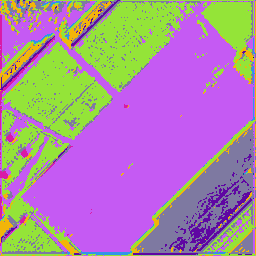

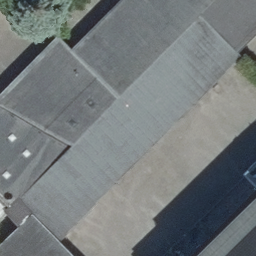

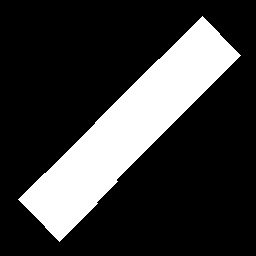




1 / 100 |  label num : 10  | loss : tf.Tensor(5.5070457, shape=(), dtype=float32)
Epoch: 1
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


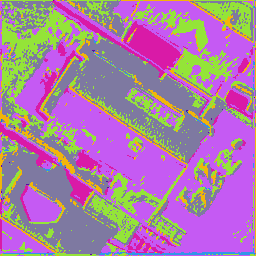

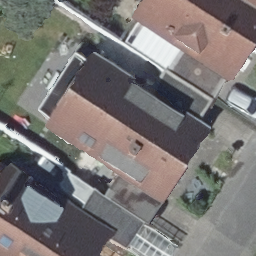

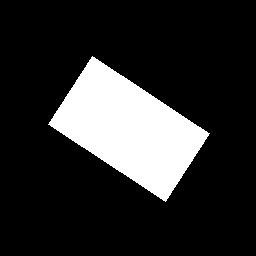




2 / 100 |  label num : 10  | loss : tf.Tensor(6.380449, shape=(), dtype=float32)
Epoch: 2
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


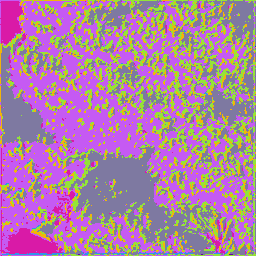

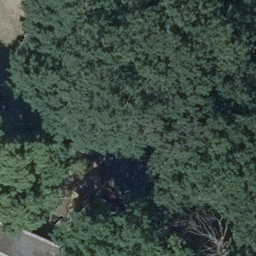

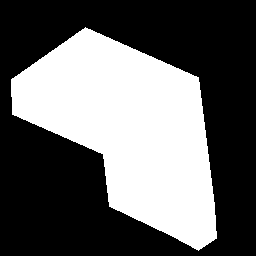




3 / 100 |  label num : 9  | loss : tf.Tensor(6.873286, shape=(), dtype=float32)
Epoch: 3
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


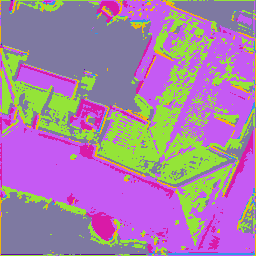

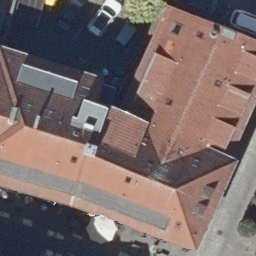

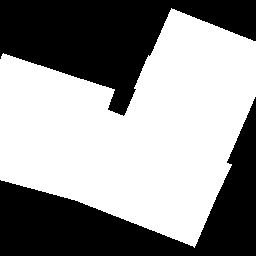




4 / 100 |  label num : 9  | loss : tf.Tensor(5.904539, shape=(), dtype=float32)
Epoch: 4
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


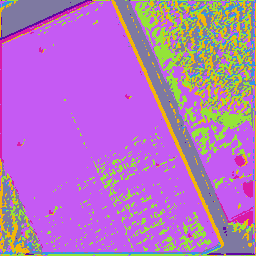

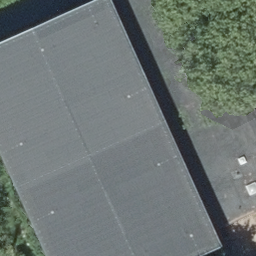

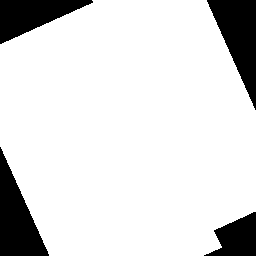




5 / 100 |  label num : 11  | loss : tf.Tensor(6.136999, shape=(), dtype=float32)
Epoch: 5
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


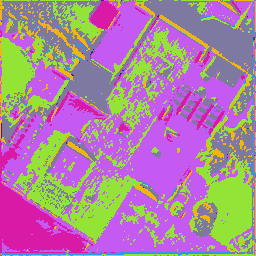

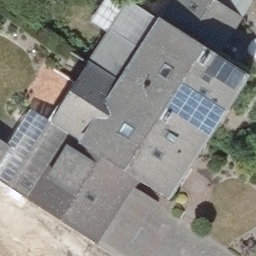

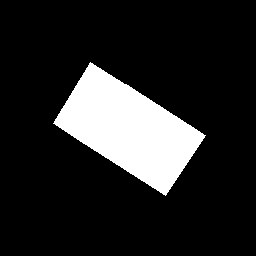




6 / 100 |  label num : 10  | loss : tf.Tensor(6.502634, shape=(), dtype=float32)
Epoch: 6
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


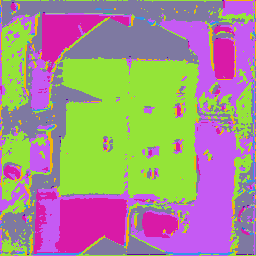

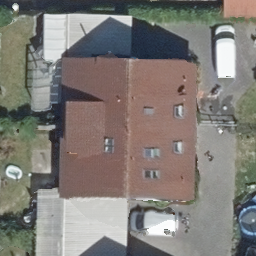

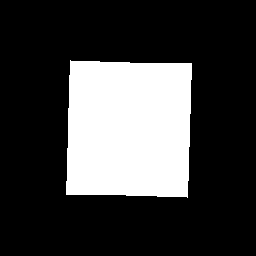




7 / 100 |  label num : 11  | loss : tf.Tensor(5.953605, shape=(), dtype=float32)
Epoch: 7
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


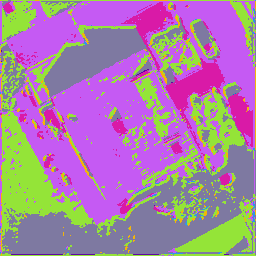

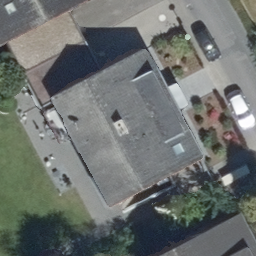

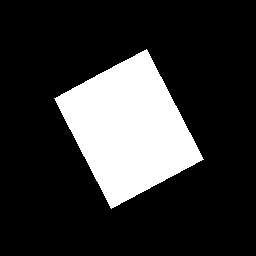




8 / 100 |  label num : 9  | loss : tf.Tensor(5.592593, shape=(), dtype=float32)
Epoch: 8
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


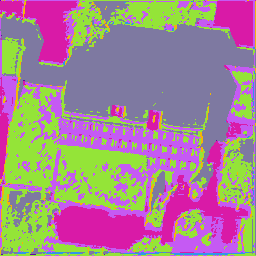

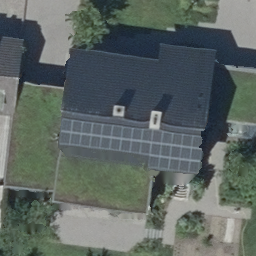

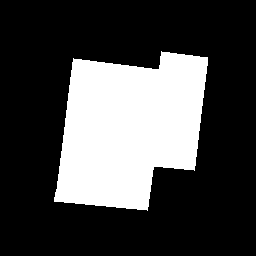




9 / 100 |  label num : 8  | loss : tf.Tensor(5.4340763, shape=(), dtype=float32)
Epoch: 9
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


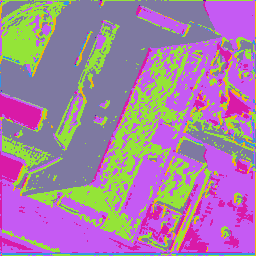

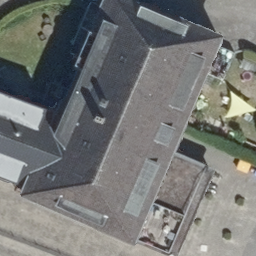

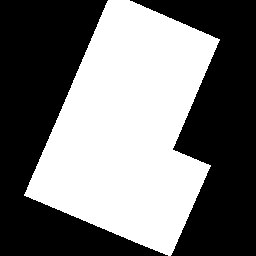




10 / 100 |  label num : 10  | loss : tf.Tensor(6.6377673, shape=(), dtype=float32)
Epoch: 10
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


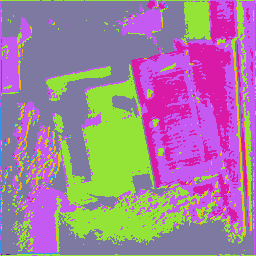

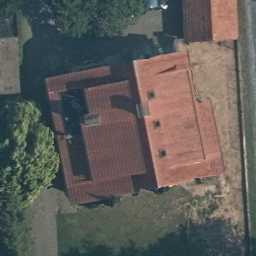

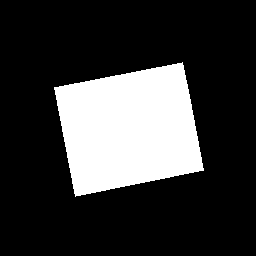




11 / 100 |  label num : 8  | loss : tf.Tensor(5.4380713, shape=(), dtype=float32)
Epoch: 11
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


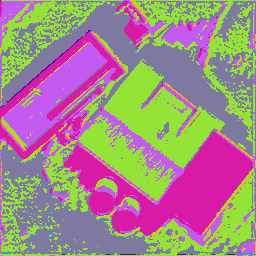

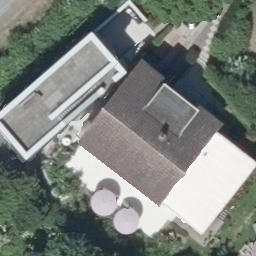

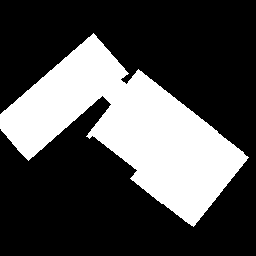




12 / 100 |  label num : 9  | loss : tf.Tensor(5.75935, shape=(), dtype=float32)
Epoch: 12
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


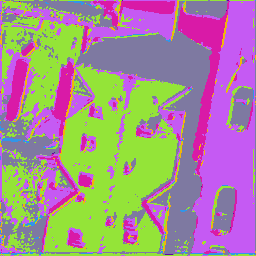

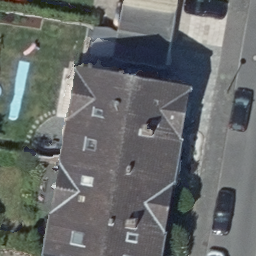

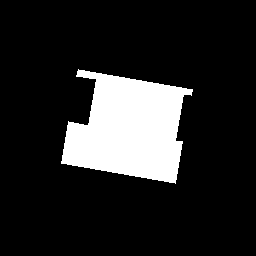




13 / 100 |  label num : 8  | loss : tf.Tensor(5.5345826, shape=(), dtype=float32)
Epoch: 13
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


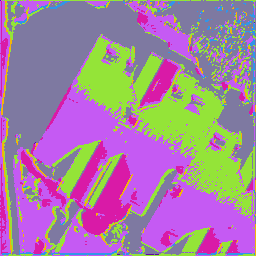

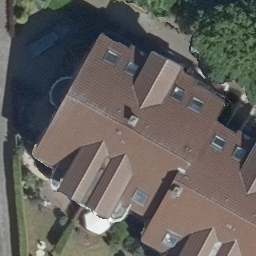

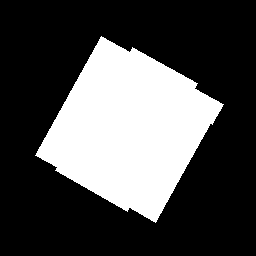




14 / 100 |  label num : 8  | loss : tf.Tensor(5.413936, shape=(), dtype=float32)
Epoch: 14
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


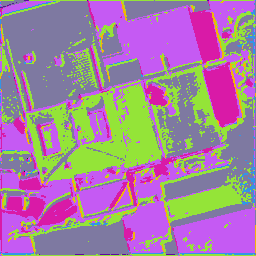

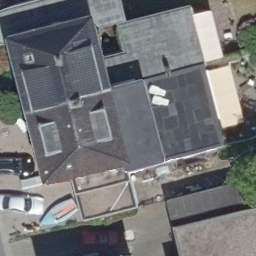

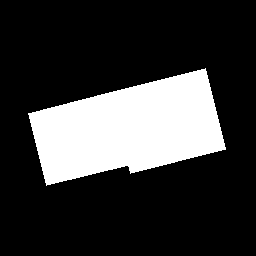




15 / 100 |  label num : 10  | loss : tf.Tensor(5.3857584, shape=(), dtype=float32)
Epoch: 15
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


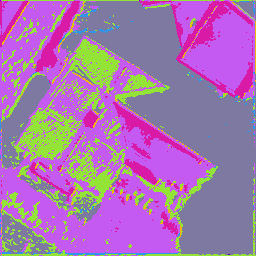

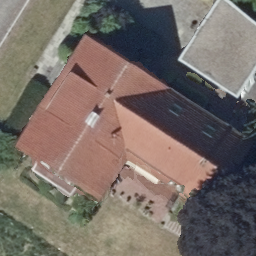

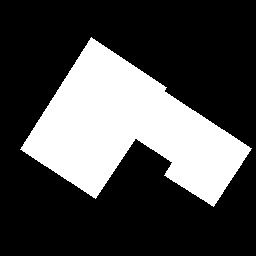




16 / 100 |  label num : 8  | loss : tf.Tensor(5.1046367, shape=(), dtype=float32)
Epoch: 16
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


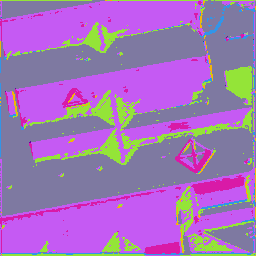

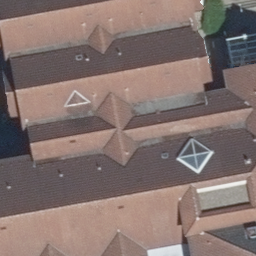

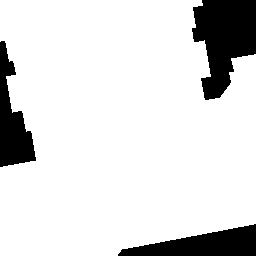




17 / 100 |  label num : 10  | loss : tf.Tensor(5.759955, shape=(), dtype=float32)
Epoch: 17
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


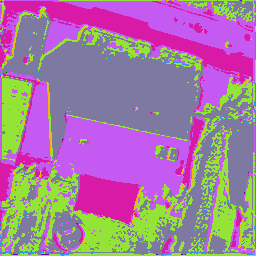

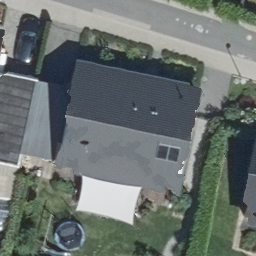

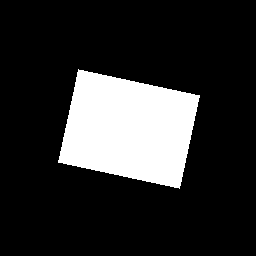




18 / 100 |  label num : 11  | loss : tf.Tensor(5.0748653, shape=(), dtype=float32)
Epoch: 18
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


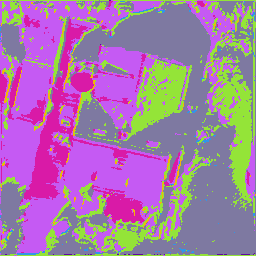

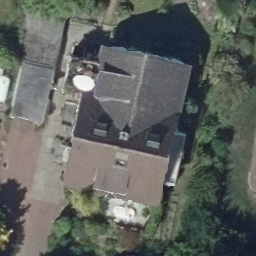

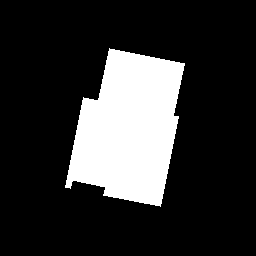




19 / 100 |  label num : 7  | loss : tf.Tensor(5.110996, shape=(), dtype=float32)
Epoch: 19
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


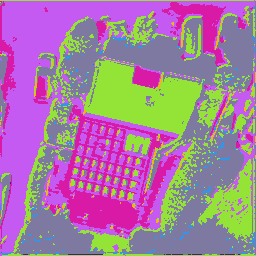

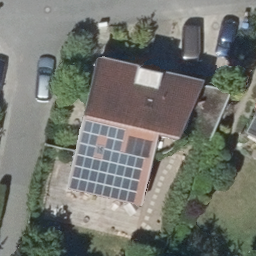

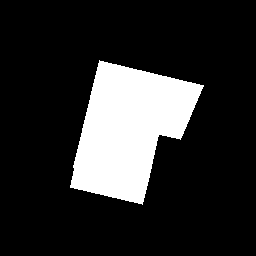




20 / 100 |  label num : 9  | loss : tf.Tensor(4.8968077, shape=(), dtype=float32)
Epoch: 20
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


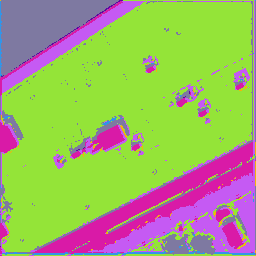

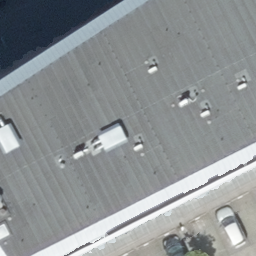

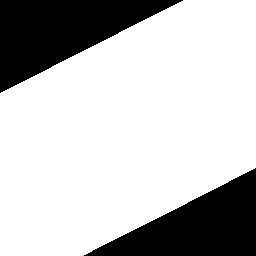




21 / 100 |  label num : 9  | loss : tf.Tensor(5.5108943, shape=(), dtype=float32)
Epoch: 21
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


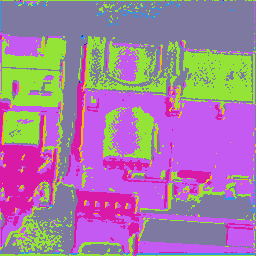

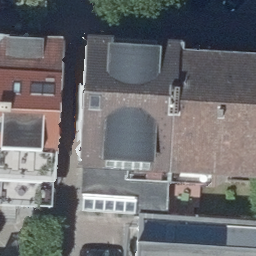

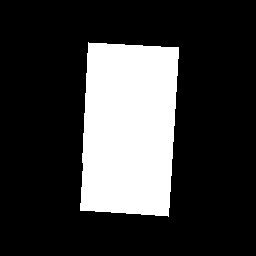




22 / 100 |  label num : 10  | loss : tf.Tensor(5.2999735, shape=(), dtype=float32)
Epoch: 22
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


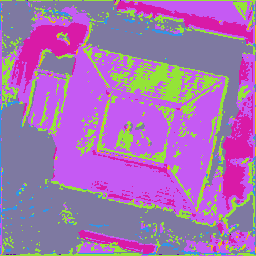

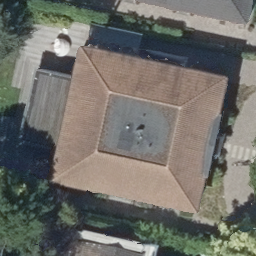

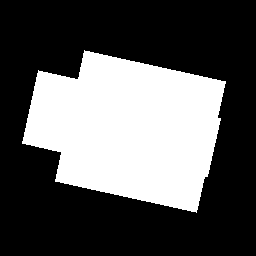




23 / 100 |  label num : 9  | loss : tf.Tensor(5.074978, shape=(), dtype=float32)
Epoch: 23
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


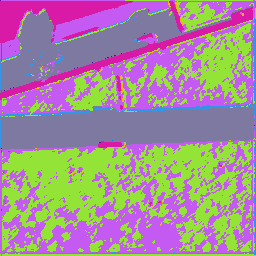

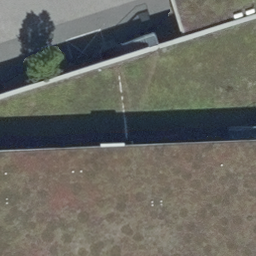

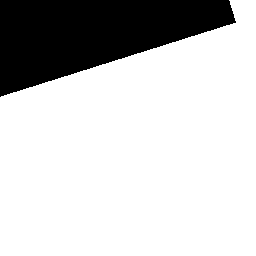




24 / 100 |  label num : 10  | loss : tf.Tensor(5.294919, shape=(), dtype=float32)
Epoch: 24
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


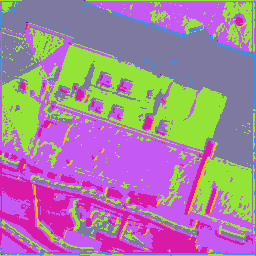

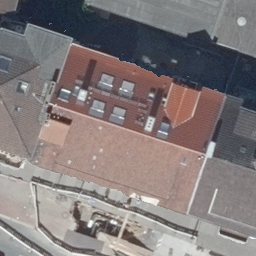

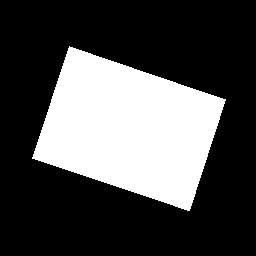




25 / 100 |  label num : 9  | loss : tf.Tensor(4.860395, shape=(), dtype=float32)
Epoch: 25
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


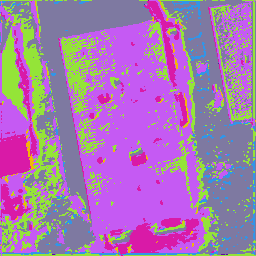

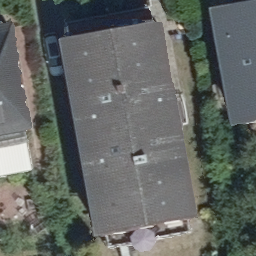

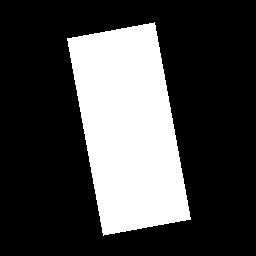




26 / 100 |  label num : 8  | loss : tf.Tensor(5.443022, shape=(), dtype=float32)
Epoch: 26
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


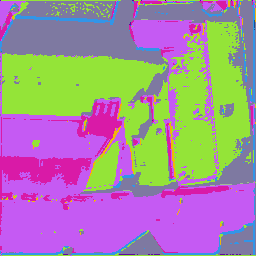

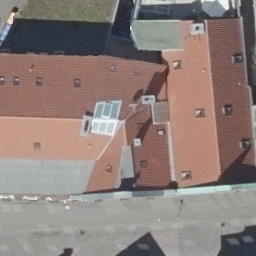

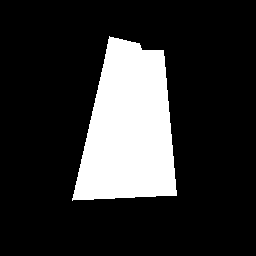




27 / 100 |  label num : 11  | loss : tf.Tensor(5.0744605, shape=(), dtype=float32)
Epoch: 27
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


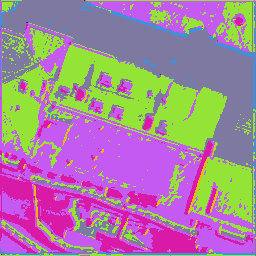

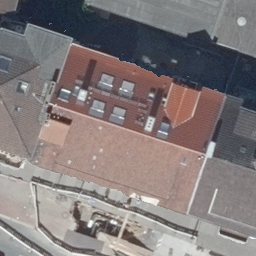

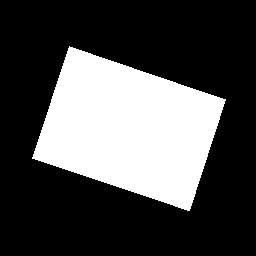




28 / 100 |  label num : 9  | loss : tf.Tensor(4.7754917, shape=(), dtype=float32)
Epoch: 28
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


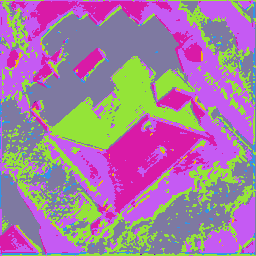

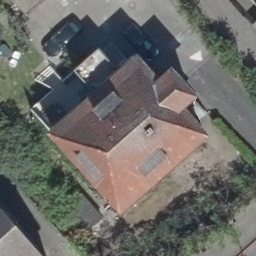

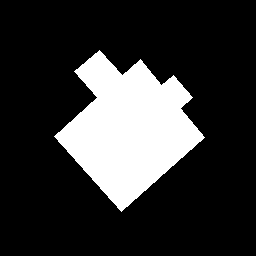




29 / 100 |  label num : 7  | loss : tf.Tensor(5.338876, shape=(), dtype=float32)
Epoch: 29
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


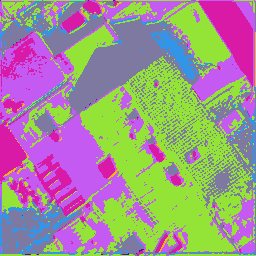

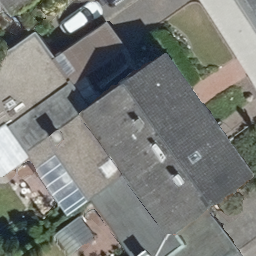

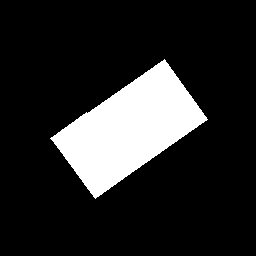




30 / 100 |  label num : 8  | loss : tf.Tensor(4.88307, shape=(), dtype=float32)
Epoch: 30
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


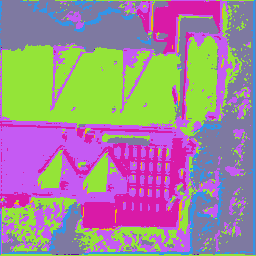

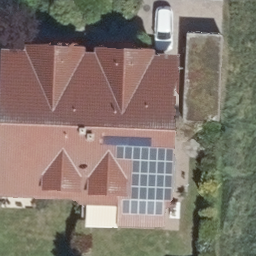

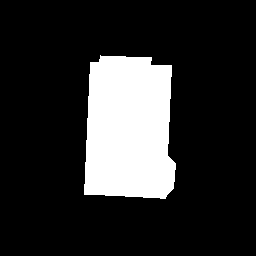




31 / 100 |  label num : 7  | loss : tf.Tensor(4.5261726, shape=(), dtype=float32)
Epoch: 31
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


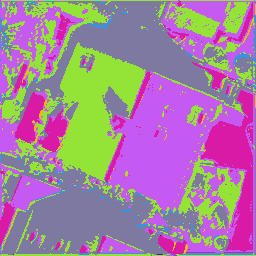

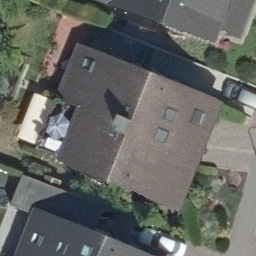

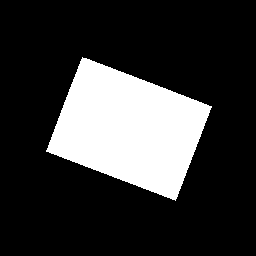




32 / 100 |  label num : 7  | loss : tf.Tensor(4.9870577, shape=(), dtype=float32)
Epoch: 32
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


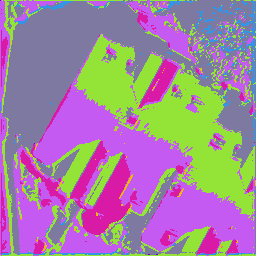

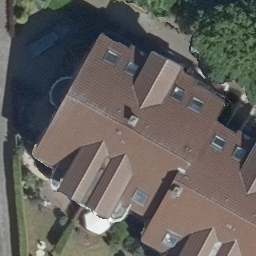

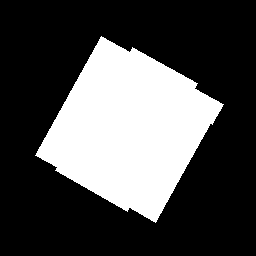




33 / 100 |  label num : 8  | loss : tf.Tensor(5.007054, shape=(), dtype=float32)
Epoch: 33
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


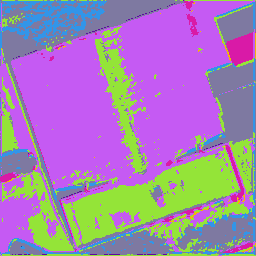

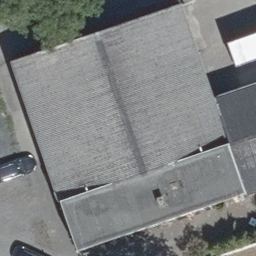

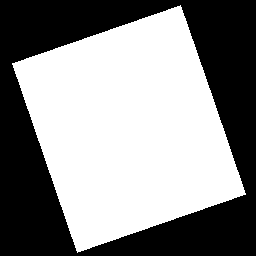




34 / 100 |  label num : 9  | loss : tf.Tensor(4.6714725, shape=(), dtype=float32)
Epoch: 34
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


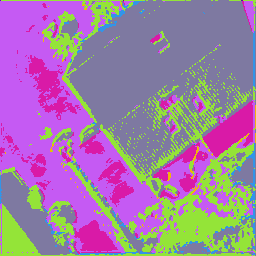

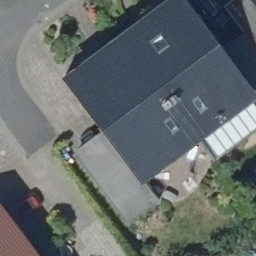

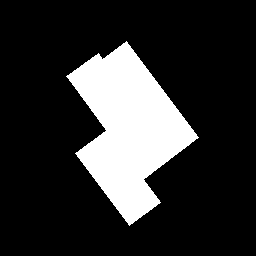




35 / 100 |  label num : 8  | loss : tf.Tensor(5.021011, shape=(), dtype=float32)
Epoch: 35
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


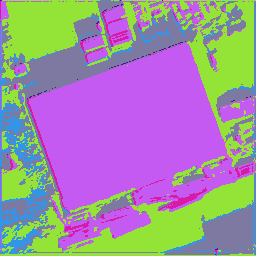

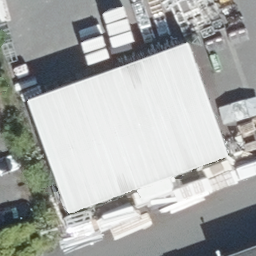

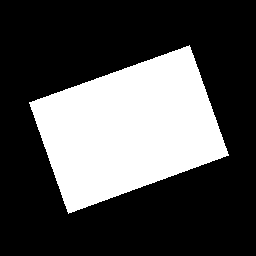




36 / 100 |  label num : 8  | loss : tf.Tensor(4.64683, shape=(), dtype=float32)
Epoch: 36
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


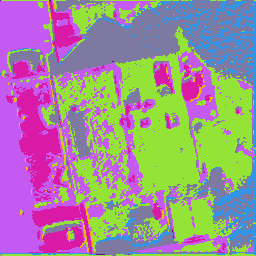

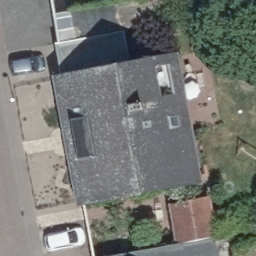

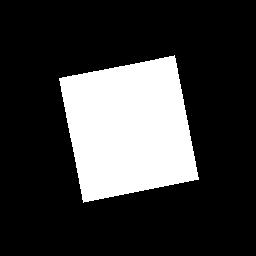




37 / 100 |  label num : 7  | loss : tf.Tensor(4.652689, shape=(), dtype=float32)
Epoch: 37
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


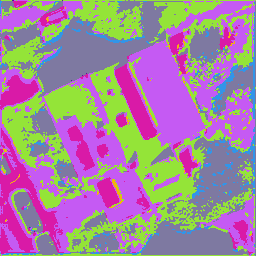

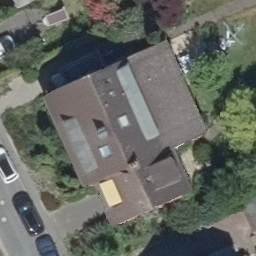

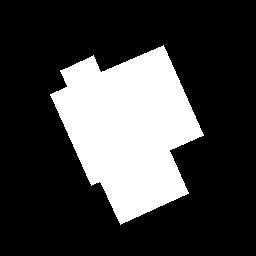




38 / 100 |  label num : 8  | loss : tf.Tensor(4.396855, shape=(), dtype=float32)
Epoch: 38
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


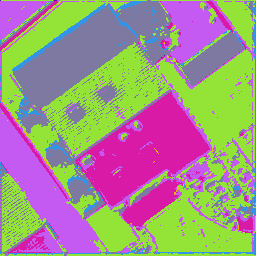

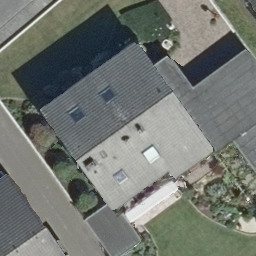

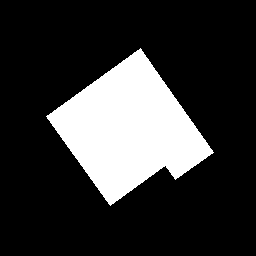




39 / 100 |  label num : 7  | loss : tf.Tensor(4.672786, shape=(), dtype=float32)
Epoch: 39
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


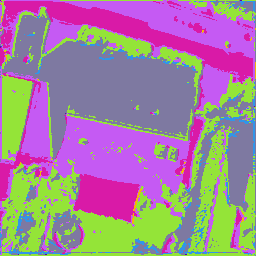

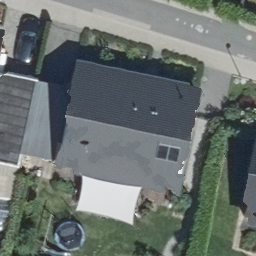

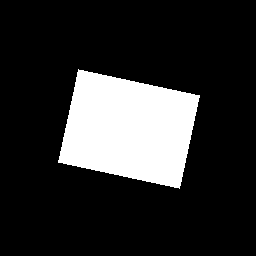




40 / 100 |  label num : 8  | loss : tf.Tensor(4.855439, shape=(), dtype=float32)
Epoch: 40
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


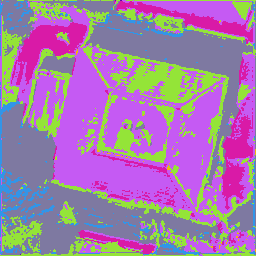

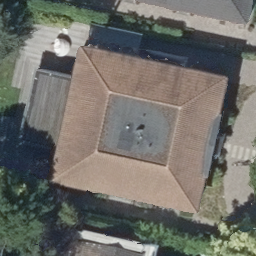

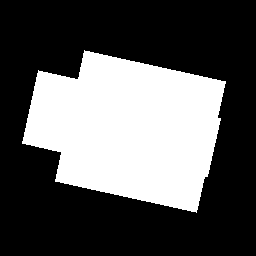




41 / 100 |  label num : 7  | loss : tf.Tensor(4.430234, shape=(), dtype=float32)
Epoch: 41
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


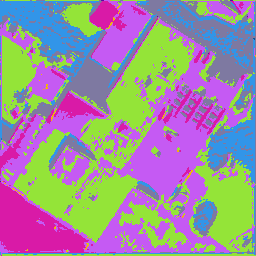

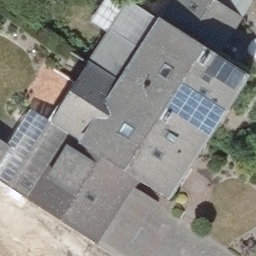

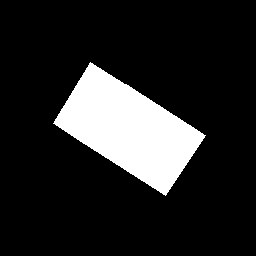




42 / 100 |  label num : 10  | loss : tf.Tensor(4.7639656, shape=(), dtype=float32)
Epoch: 42
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


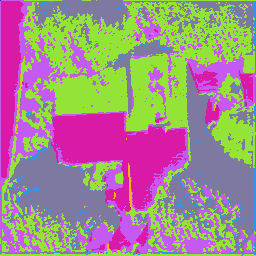

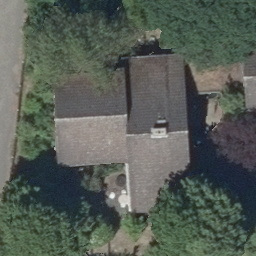

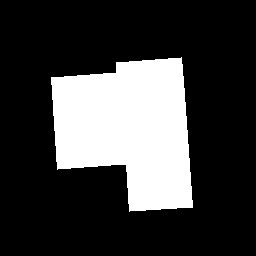




43 / 100 |  label num : 7  | loss : tf.Tensor(4.687875, shape=(), dtype=float32)
Epoch: 43
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


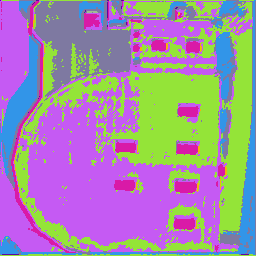

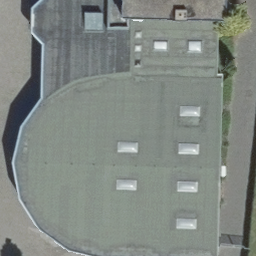

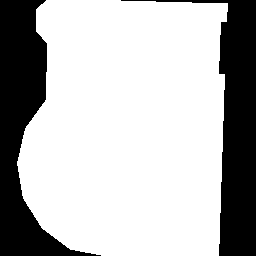




44 / 100 |  label num : 9  | loss : tf.Tensor(4.7656, shape=(), dtype=float32)
Epoch: 44
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


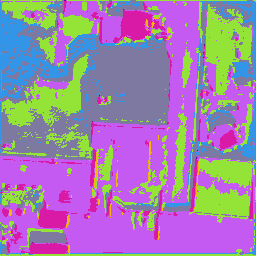

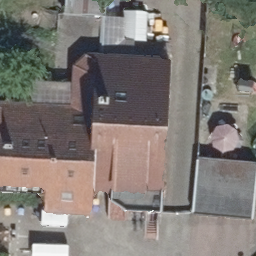

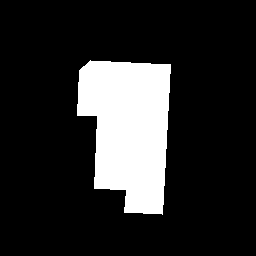




45 / 100 |  label num : 7  | loss : tf.Tensor(4.2030587, shape=(), dtype=float32)
Epoch: 45
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


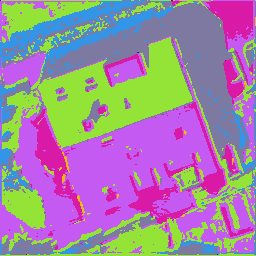

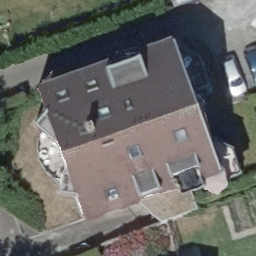

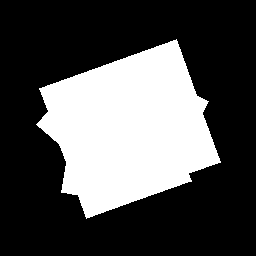




46 / 100 |  label num : 7  | loss : tf.Tensor(4.643606, shape=(), dtype=float32)
Epoch: 46
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


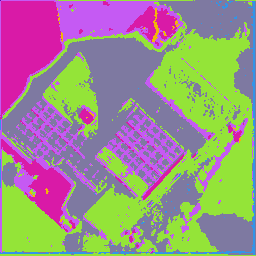

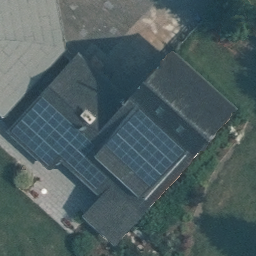

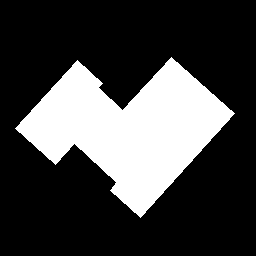




47 / 100 |  label num : 7  | loss : tf.Tensor(4.6619387, shape=(), dtype=float32)
Epoch: 47
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


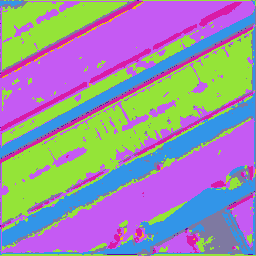

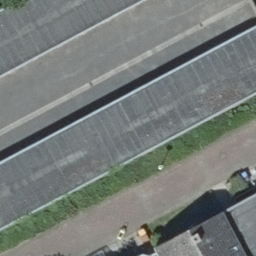

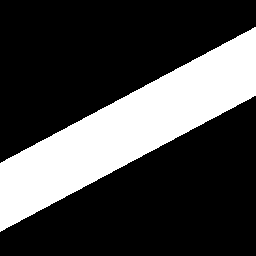




48 / 100 |  label num : 9  | loss : tf.Tensor(4.5870633, shape=(), dtype=float32)
Epoch: 48
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


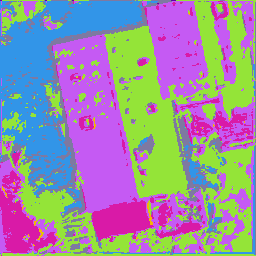

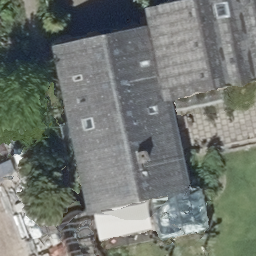

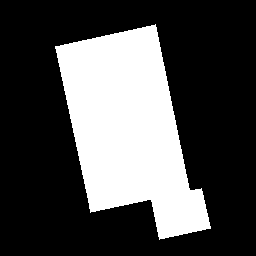




49 / 100 |  label num : 8  | loss : tf.Tensor(4.766267, shape=(), dtype=float32)
Epoch: 49
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


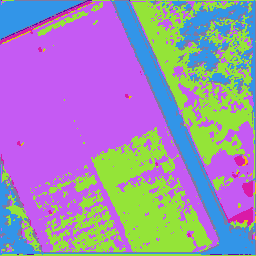

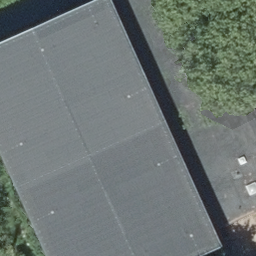

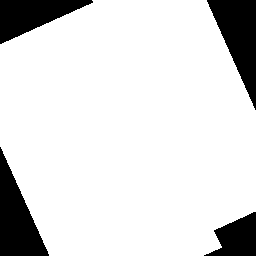




50 / 100 |  label num : 8  | loss : tf.Tensor(4.512049, shape=(), dtype=float32)
Epoch: 50
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


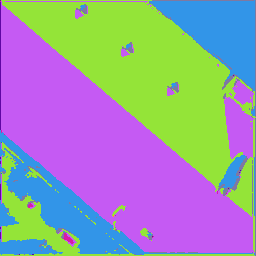

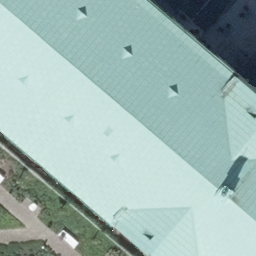

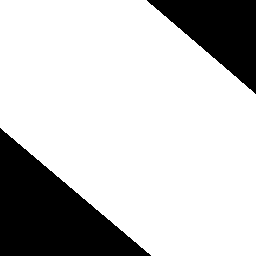




51 / 100 |  label num : 8  | loss : tf.Tensor(4.533318, shape=(), dtype=float32)
Epoch: 51
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


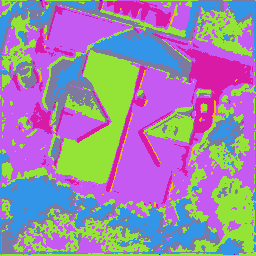

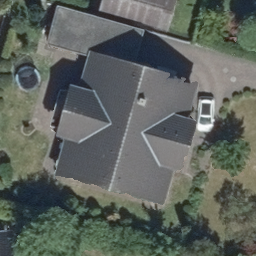

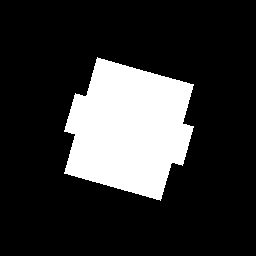




52 / 100 |  label num : 7  | loss : tf.Tensor(4.71211, shape=(), dtype=float32)
Epoch: 52
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


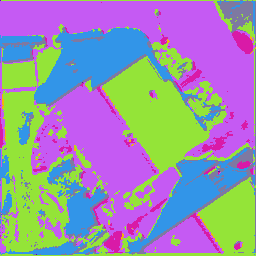

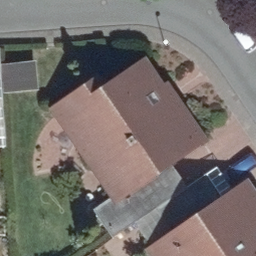

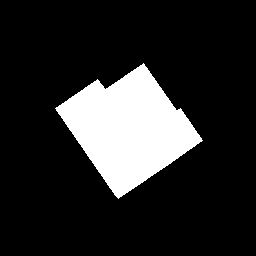




53 / 100 |  label num : 8  | loss : tf.Tensor(4.649082, shape=(), dtype=float32)
Epoch: 53
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


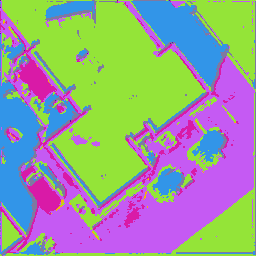

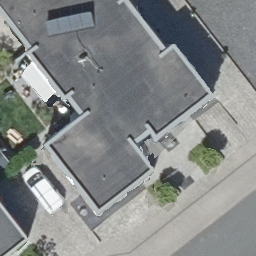

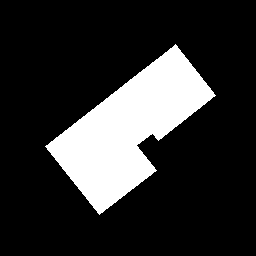




54 / 100 |  label num : 7  | loss : tf.Tensor(4.0131893, shape=(), dtype=float32)
Epoch: 54
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


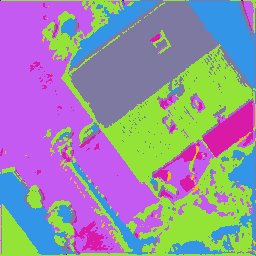

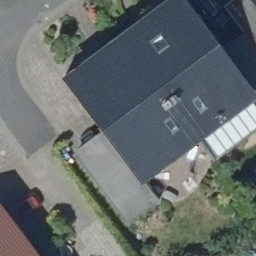

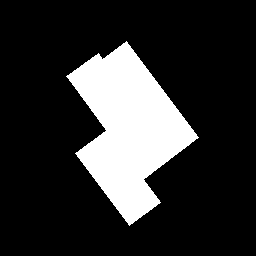




55 / 100 |  label num : 7  | loss : tf.Tensor(4.4190626, shape=(), dtype=float32)
Epoch: 55
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


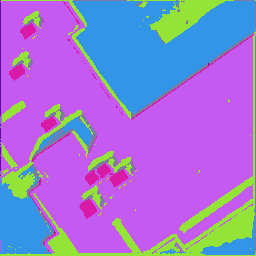

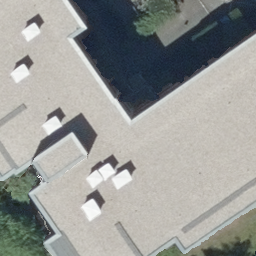

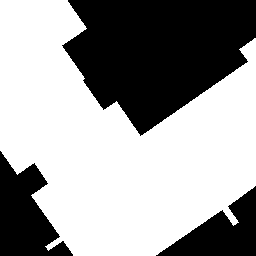




56 / 100 |  label num : 7  | loss : tf.Tensor(4.215697, shape=(), dtype=float32)
Epoch: 56
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


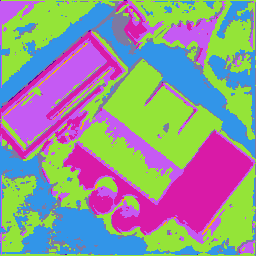

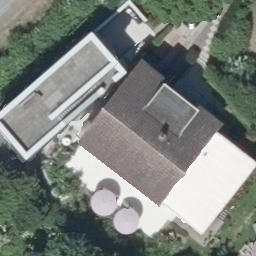

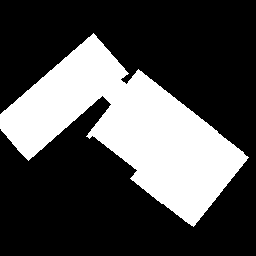




57 / 100 |  label num : 8  | loss : tf.Tensor(4.271362, shape=(), dtype=float32)
Epoch: 57
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


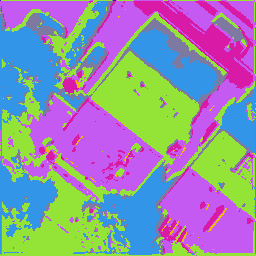

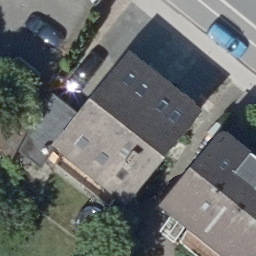

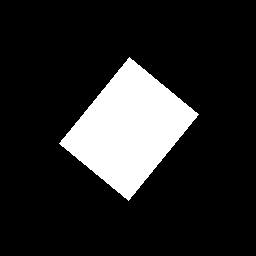




58 / 100 |  label num : 8  | loss : tf.Tensor(4.1848125, shape=(), dtype=float32)
Epoch: 58
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


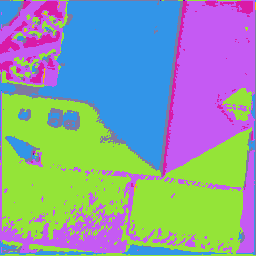

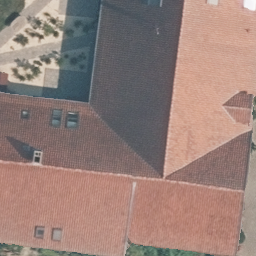

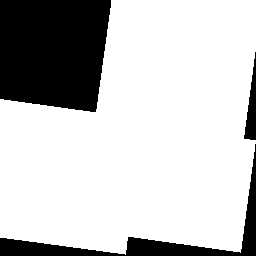




59 / 100 |  label num : 8  | loss : tf.Tensor(4.4361935, shape=(), dtype=float32)
Epoch: 59
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


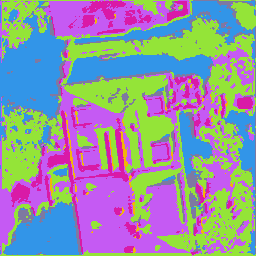

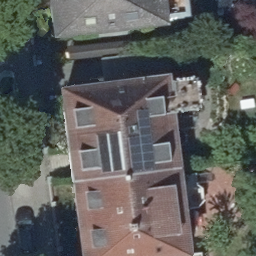

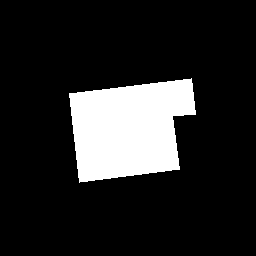




60 / 100 |  label num : 7  | loss : tf.Tensor(4.067997, shape=(), dtype=float32)
Epoch: 60
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


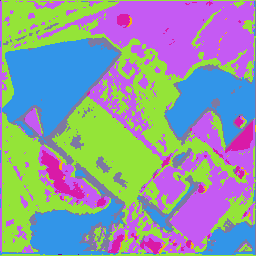

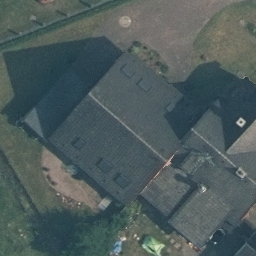

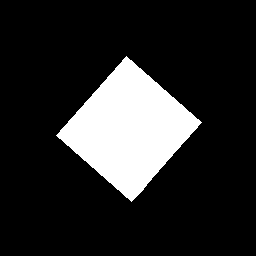




61 / 100 |  label num : 7  | loss : tf.Tensor(4.262202, shape=(), dtype=float32)
Epoch: 61
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


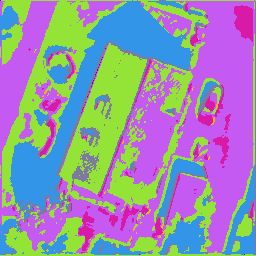

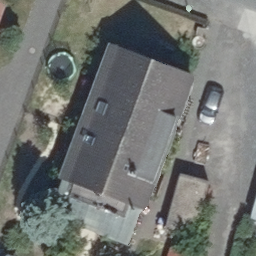

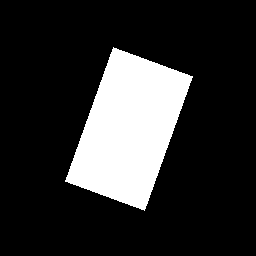




62 / 100 |  label num : 7  | loss : tf.Tensor(4.1972733, shape=(), dtype=float32)
Epoch: 62
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


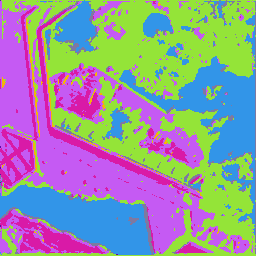

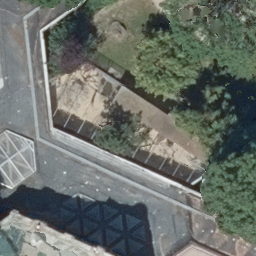

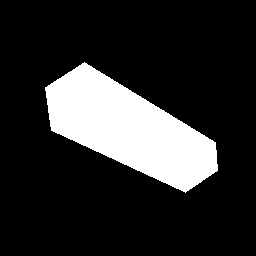




63 / 100 |  label num : 8  | loss : tf.Tensor(3.9097655, shape=(), dtype=float32)
Epoch: 63
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


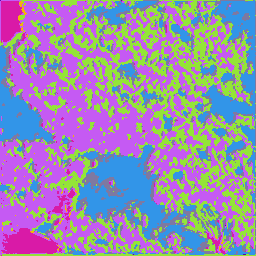

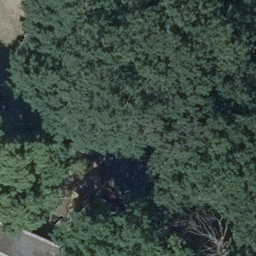

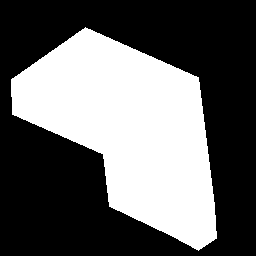




64 / 100 |  label num : 7  | loss : tf.Tensor(4.184369, shape=(), dtype=float32)
Epoch: 64
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


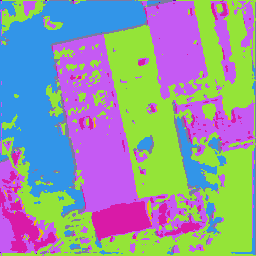

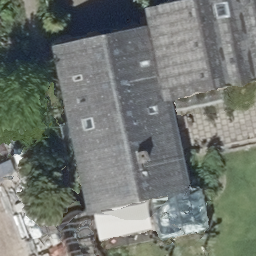

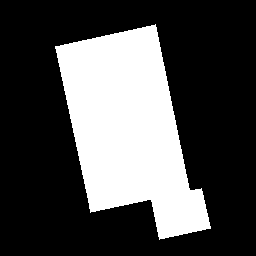




65 / 100 |  label num : 8  | loss : tf.Tensor(4.0601897, shape=(), dtype=float32)
Epoch: 65
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


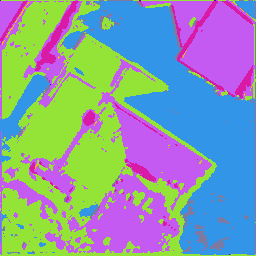

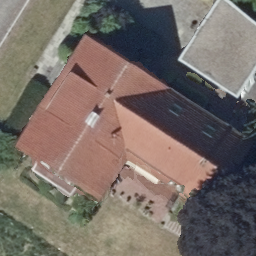

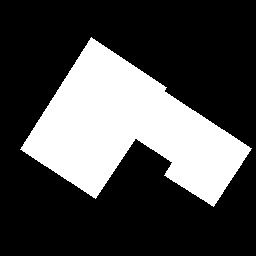




66 / 100 |  label num : 7  | loss : tf.Tensor(3.83786, shape=(), dtype=float32)
Epoch: 66
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


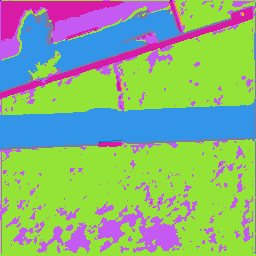

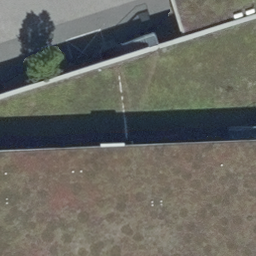

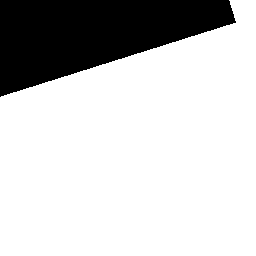




67 / 100 |  label num : 8  | loss : tf.Tensor(4.0602303, shape=(), dtype=float32)
Epoch: 67
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


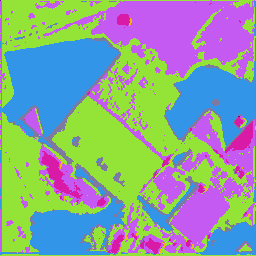

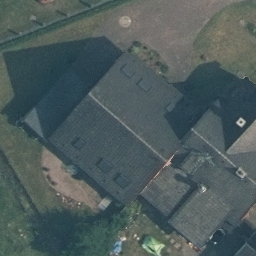

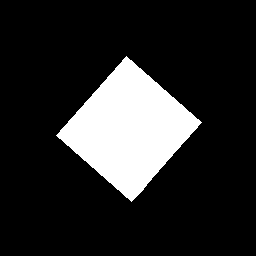




68 / 100 |  label num : 7  | loss : tf.Tensor(3.966512, shape=(), dtype=float32)
Epoch: 68
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


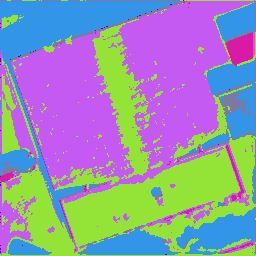

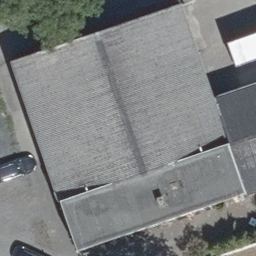

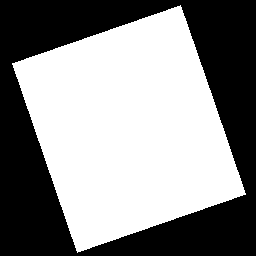




69 / 100 |  label num : 8  | loss : tf.Tensor(3.9596994, shape=(), dtype=float32)
Epoch: 69
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


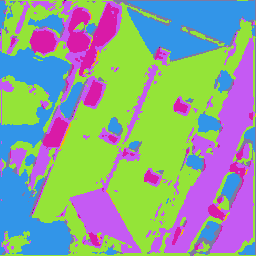

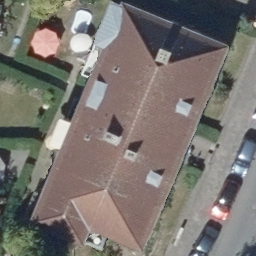

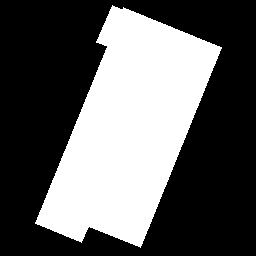




70 / 100 |  label num : 7  | loss : tf.Tensor(3.943874, shape=(), dtype=float32)
Epoch: 70
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


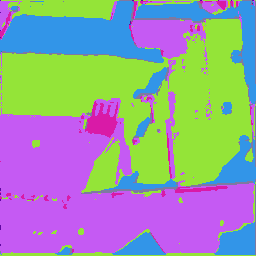

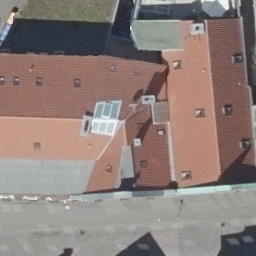

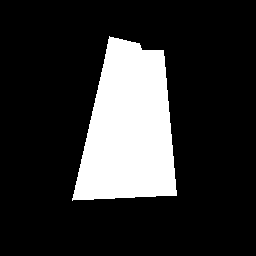




71 / 100 |  label num : 8  | loss : tf.Tensor(4.0060663, shape=(), dtype=float32)
Epoch: 71
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


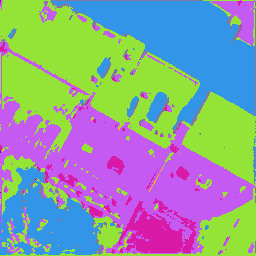

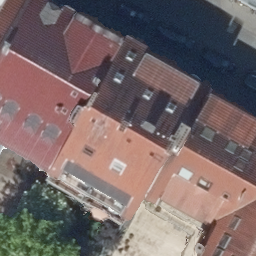

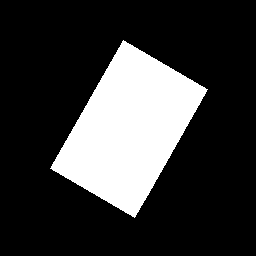




72 / 100 |  label num : 7  | loss : tf.Tensor(3.9660165, shape=(), dtype=float32)
Epoch: 72
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


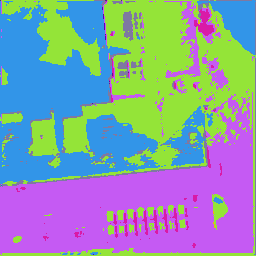

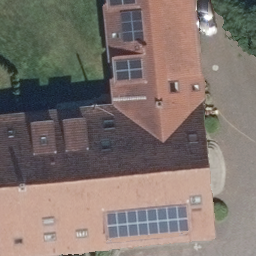

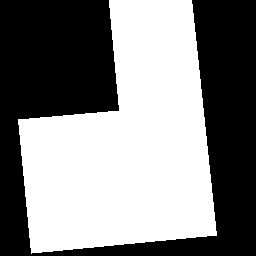




73 / 100 |  label num : 8  | loss : tf.Tensor(3.972829, shape=(), dtype=float32)
Epoch: 73
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


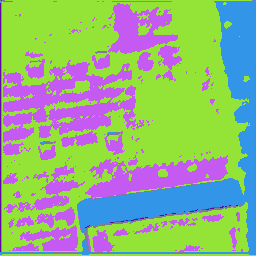

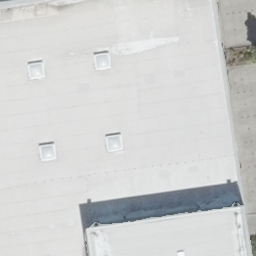

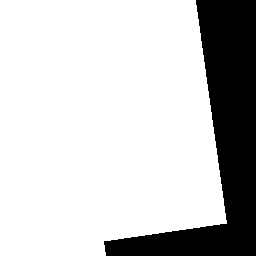




74 / 100 |  label num : 8  | loss : tf.Tensor(4.1117268, shape=(), dtype=float32)
Epoch: 74
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


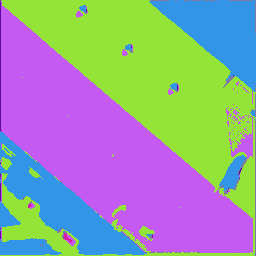

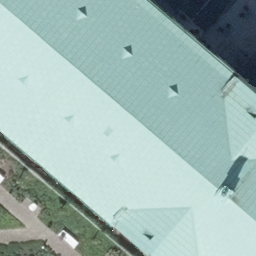

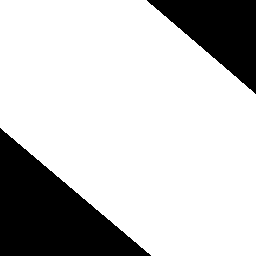




75 / 100 |  label num : 8  | loss : tf.Tensor(3.7142954, shape=(), dtype=float32)
Epoch: 75
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


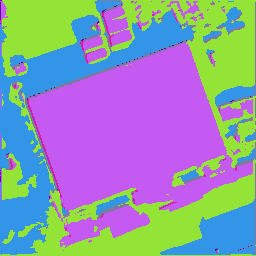

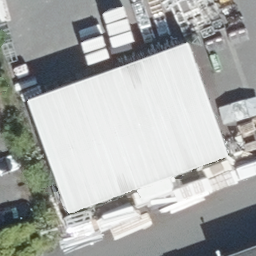

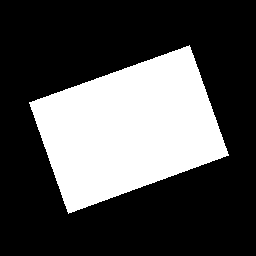




76 / 100 |  label num : 8  | loss : tf.Tensor(3.7791362, shape=(), dtype=float32)
Epoch: 76
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


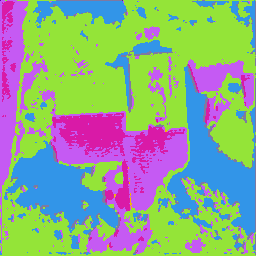

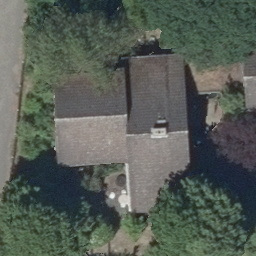

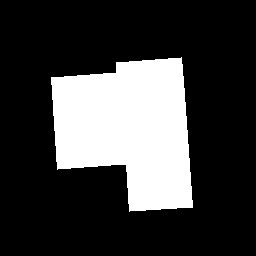




77 / 100 |  label num : 7  | loss : tf.Tensor(3.655158, shape=(), dtype=float32)
Epoch: 77
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


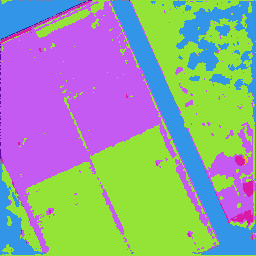

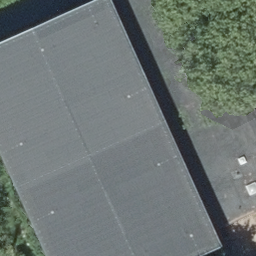

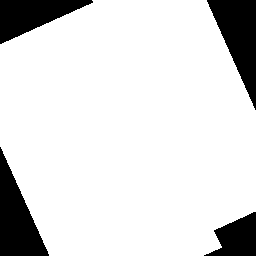




78 / 100 |  label num : 8  | loss : tf.Tensor(3.9118543, shape=(), dtype=float32)
Epoch: 78
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


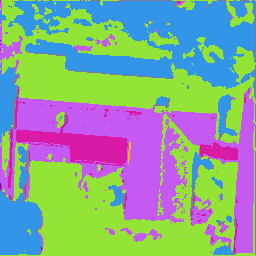

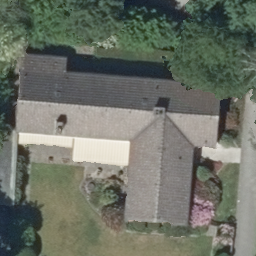

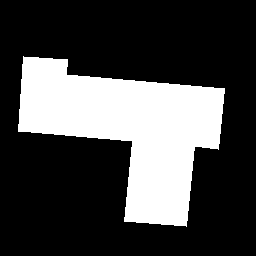




79 / 100 |  label num : 7  | loss : tf.Tensor(3.8666573, shape=(), dtype=float32)
Epoch: 79
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


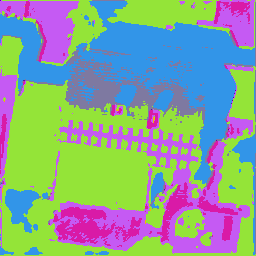

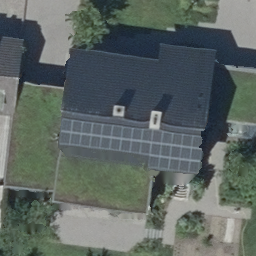

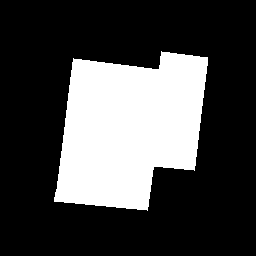




80 / 100 |  label num : 8  | loss : tf.Tensor(3.746732, shape=(), dtype=float32)
Epoch: 80
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


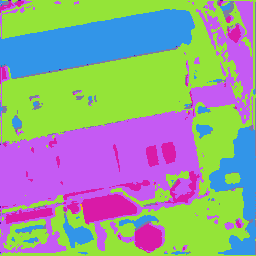

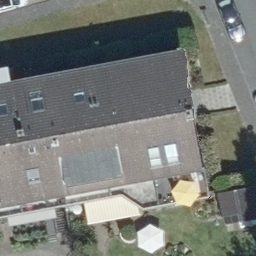

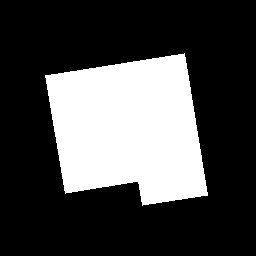




81 / 100 |  label num : 8  | loss : tf.Tensor(3.8277833, shape=(), dtype=float32)
Epoch: 81
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


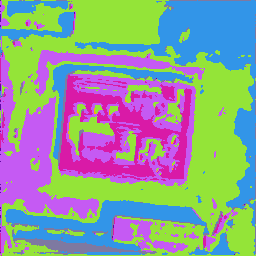

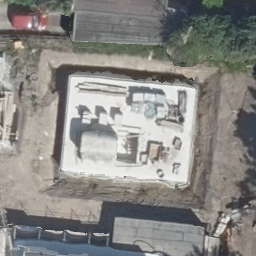

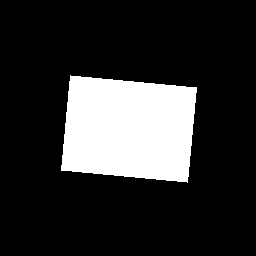




82 / 100 |  label num : 8  | loss : tf.Tensor(3.7403276, shape=(), dtype=float32)
Epoch: 82
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


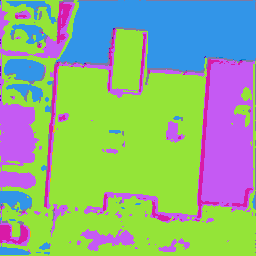

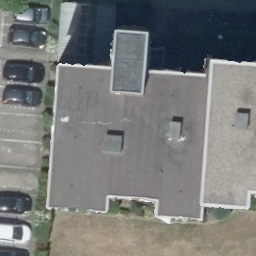

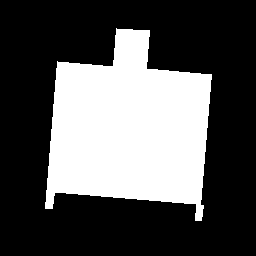




83 / 100 |  label num : 8  | loss : tf.Tensor(3.855466, shape=(), dtype=float32)
Epoch: 83
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


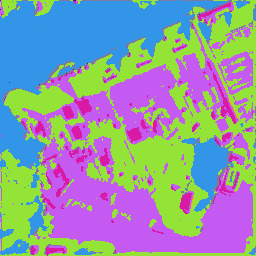

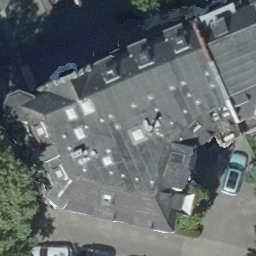

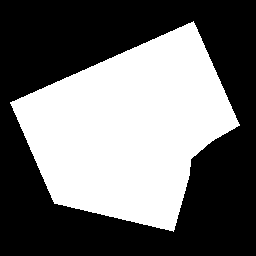




84 / 100 |  label num : 8  | loss : tf.Tensor(3.6392293, shape=(), dtype=float32)
Epoch: 84
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


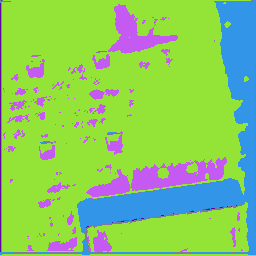

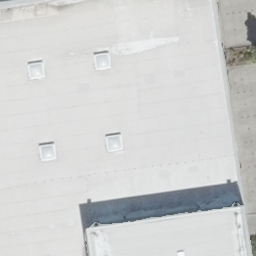

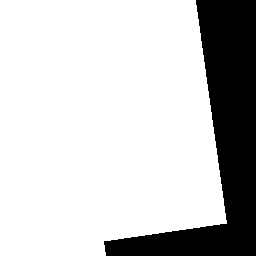




85 / 100 |  label num : 6  | loss : tf.Tensor(4.0629992, shape=(), dtype=float32)
Epoch: 85
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


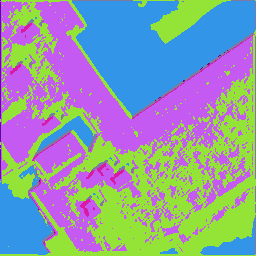

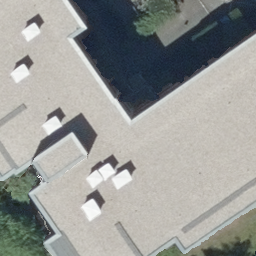

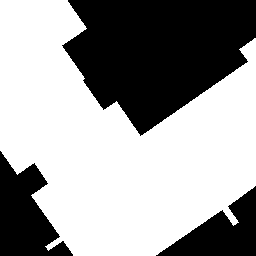




86 / 100 |  label num : 6  | loss : tf.Tensor(3.5590243, shape=(), dtype=float32)
Epoch: 86
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


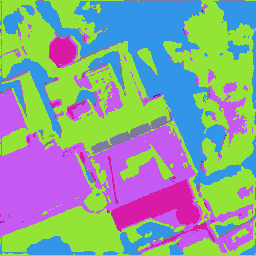

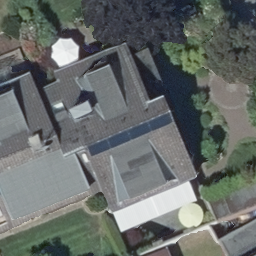

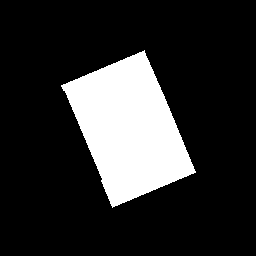




87 / 100 |  label num : 8  | loss : tf.Tensor(3.51552, shape=(), dtype=float32)
Epoch: 87
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


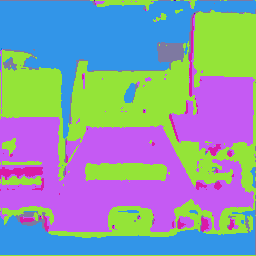

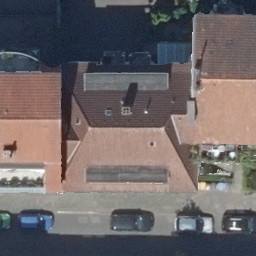

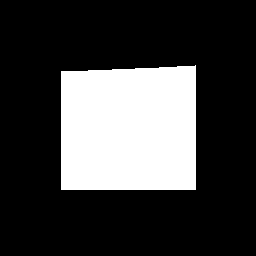




88 / 100 |  label num : 8  | loss : tf.Tensor(3.7438686, shape=(), dtype=float32)
Epoch: 88
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


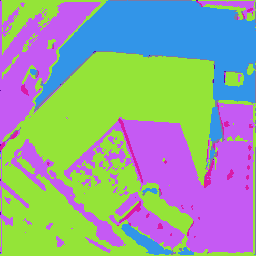

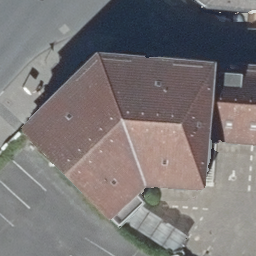

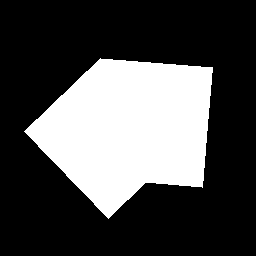




89 / 100 |  label num : 7  | loss : tf.Tensor(3.711726, shape=(), dtype=float32)
Epoch: 89
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


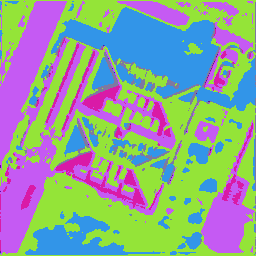

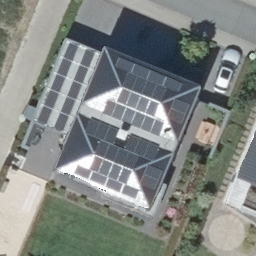

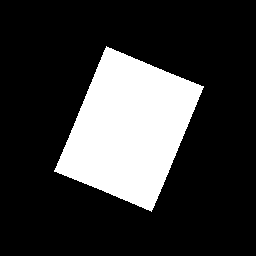




90 / 100 |  label num : 8  | loss : tf.Tensor(3.713404, shape=(), dtype=float32)
Epoch: 90
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


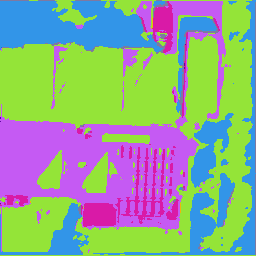

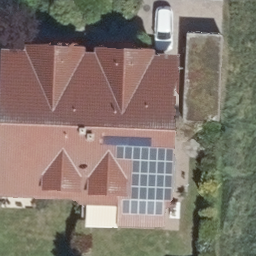

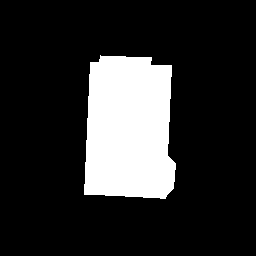




91 / 100 |  label num : 8  | loss : tf.Tensor(3.6830385, shape=(), dtype=float32)
Epoch: 91
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


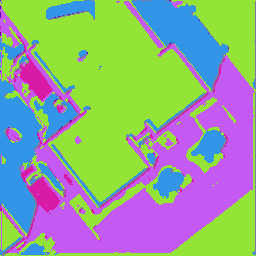

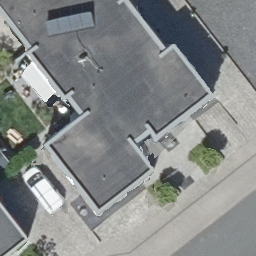

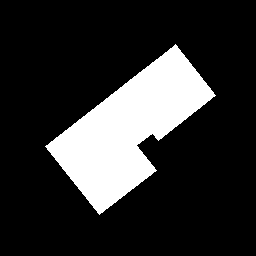




92 / 100 |  label num : 8  | loss : tf.Tensor(3.550433, shape=(), dtype=float32)
Epoch: 92
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


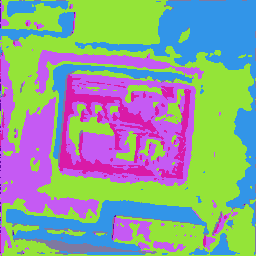

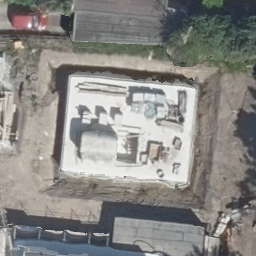

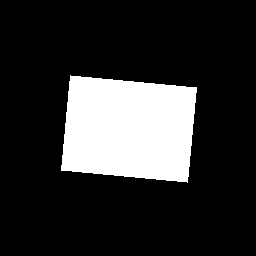




93 / 100 |  label num : 8  | loss : tf.Tensor(3.6874075, shape=(), dtype=float32)
Epoch: 93
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


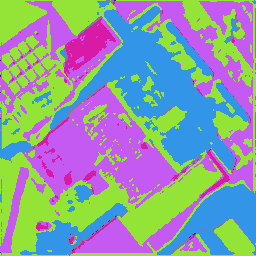

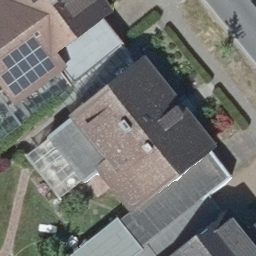

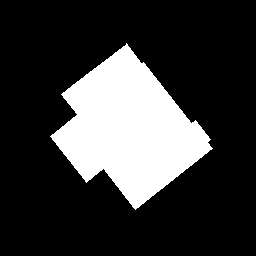




94 / 100 |  label num : 8  | loss : tf.Tensor(3.6798549, shape=(), dtype=float32)
Epoch: 94
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


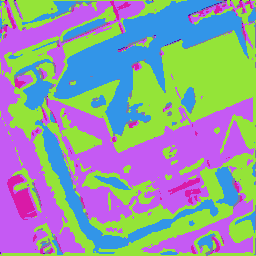

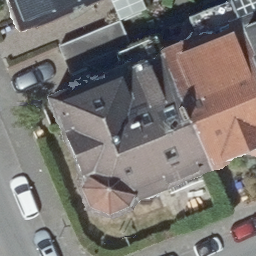

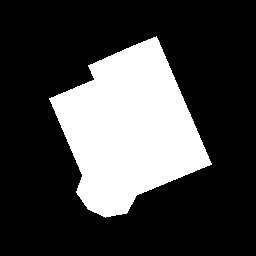




95 / 100 |  label num : 8  | loss : tf.Tensor(3.858641, shape=(), dtype=float32)
Epoch: 95
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


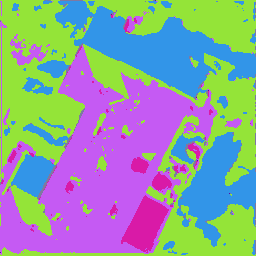

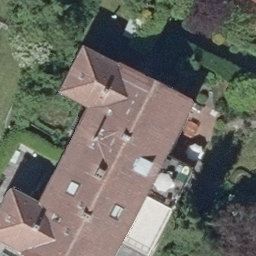

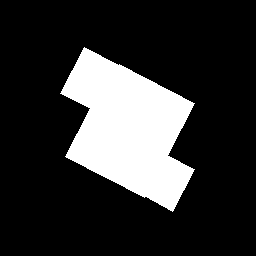




96 / 100 |  label num : 6  | loss : tf.Tensor(3.5875766, shape=(), dtype=float32)
Epoch: 96
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


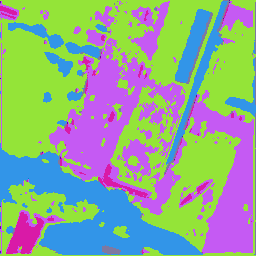

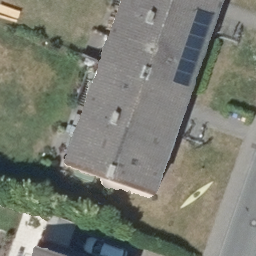

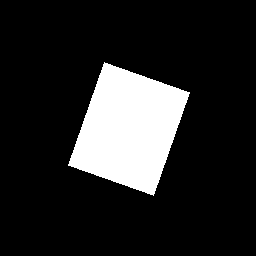




97 / 100 |  label num : 8  | loss : tf.Tensor(3.5959902, shape=(), dtype=float32)
Epoch: 97
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


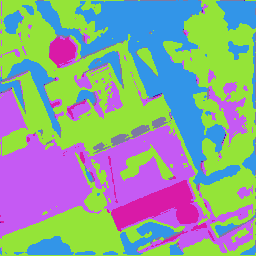

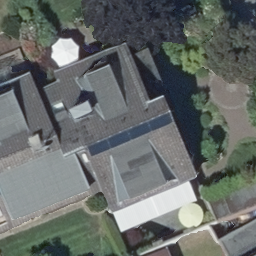

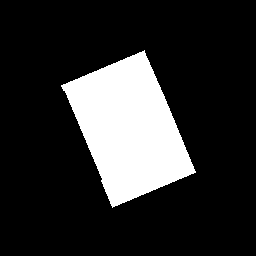




98 / 100 |  label num : 8  | loss : tf.Tensor(3.53661, shape=(), dtype=float32)
Epoch: 98
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


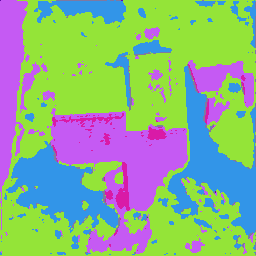

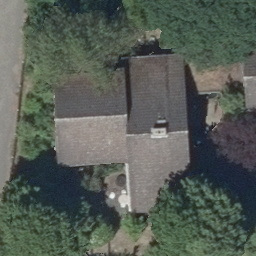

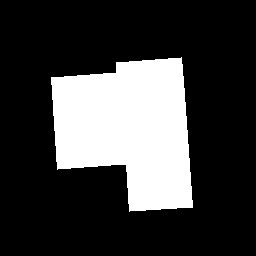




99 / 100 |  label num : 7  | loss : tf.Tensor(3.6757617, shape=(), dtype=float32)
Epoch: 99
File Nr: 0
File Nr: 1
File Nr: 2
File Nr: 3
File Nr: 4
File Nr: 5
File Nr: 6
File Nr: 7
File Nr: 8
File Nr: 9


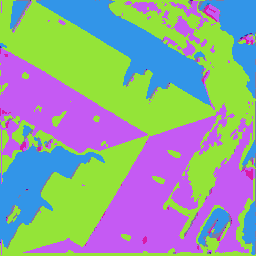

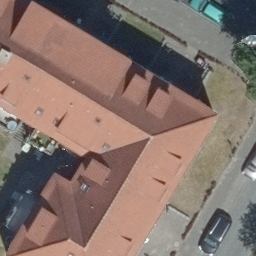

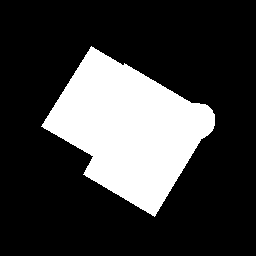




100 / 100 |  label num : 7  | loss : tf.Tensor(3.755393, shape=(), dtype=float32)


In [110]:
# train
train_losses = []

# for tensorboard
train_loss = tf.keras.metrics.Mean('train_loss', dtype=tf.float32)

# similarity loss function
loss_fn = tf.keras.losses.SparseCategoricalCrossentropy()

# continuity loss function
loss_hpy = tf.keras.losses.Huber() # really Huber?
loss_hpz = tf.keras.losses.Huber()



HPy_target = tf.zeros((my_batch_size,img.shape[0]-1, img.shape[1], nChannel))
HPz_target = tf.zeros((my_batch_size,img.shape[0], img.shape[1]-1, nChannel))

#optimizer = tf.keras.optimizers.SGD(lr=lr, momentum=0.9)
optimizer = tf.keras.optimizers.Adam(lr)

label_colours = np.random.randint(255,size=(nChannel,3))


# Start training
for epoch in range(epochs):
    #print(f'Epoch: {str(epoch)}')

    if epoch == n_epochs_pretraining and pretraining:
      print("-------------- pretraining is over --------------")
      # stop pretraining
      pretraining = False

    epoch_loss_agg = []
    i = 0
    print("Epoch: "+str(epoch))
    #dataset = dataset.skip(994)
    for (input, mask) in dataset:
      
      print("File Nr: "+str(i))
      i = i+1
      if i >= max_files_per_epoch:
        # break epoch
        break

      # print(f'Index in Data set: {ind+1}')

      input = tf.reshape(input,(my_batch_size,256,256,3))
      mask = tf.reshape(mask,(my_batch_size,256,256)) 

      if new_loss_function:
        loss, target = train_step_new_loss(model, input, loss_fn, loss_hpy, loss_hpz, optimizer, HPy_target, HPz_target, mask)
      else:
        loss, target = train_step(model, input, loss_fn, loss_hpy, loss_hpz, optimizer, HPy_target, HPz_target, mask)




      input_img = input[0].numpy()
      mask_img = mask[0].numpy()

      epoch_loss_agg.append(loss)


  
    # just select 1 target image
    target = target[0].numpy().squeeze()
    nLabels = len(np.unique(target))


    # write to tensorboard
    with train_summary_writer.as_default():
      tf.summary.scalar('loss', train_loss.result(), step=epoch)
      tf.summary.scalar('nLabels', nLabels, step=epoch)

    if visualize:
      #import pdb
      #pdb.set_trace()   
      im_target_rgb = np.array([label_colours[ c % nChannel ] for c in target])
      im_target_rgb = im_target_rgb.reshape( img.shape ).astype( np.uint8 )
      cv2_imshow( im_target_rgb )
      cv2_imshow( input_img *255)
      #print(np.any(np.any(mask_img)))
      cv2_imshow( mask_img * 255) 
      # Using the file writer, log the reshaped image.
      #print(type(np.expand_dims((input_img *255),axis=0)))
      #print(type(np.expand_dims((input_img *255),axis=0)))
      print("\n\n")
      with img_file_writer.as_default():
        tf.summary.image("Images", np.expand_dims((input_img * 255).astype( np.uint8 ),axis=0), step=epoch)
        tf.summary.image("Images", np.expand_dims(im_target_rgb,axis=0), step=epoch)

      #cv2.waitKey(1)

    train_losses.append(tf.reduce_mean(epoch_loss_agg))
    print (epoch + 1, '/', epochs, '|', ' label num :', nLabels, ' | loss :', train_losses[-1])

    # Training loss save for later visualization
    if nLabels <= minLabels:
      print ("nLabels", nLabels, "reached minLabels", minLabels, ".")
      break

    # Reset metrics every epoch
    train_loss.reset_states()



# Clustering' with K-Means


In [69]:
from sklearn.cluster import KMeans

img_convert = cv2.cvtColor(img * 255., cv2.COLOR_BGR2RGB) #convert img 
print(img.shape)

vectorized = (img * 255).reshape((-1,3))
vectorized = np.float32(vectorized)


(256, 256, 3)


In [70]:

# reshape array to get the long list of RGB colors and then cluster using KMeans()
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)


#image 1
K = 10
attempts = 10
ret,label,center = cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]
result_image1 = res.reshape((img_convert.shape))

#image 2
K = 4
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]
result_image2 = res.reshape((img_convert.shape))

#image 3
K = 2
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]
result_image3 = res.reshape((img_convert.shape))


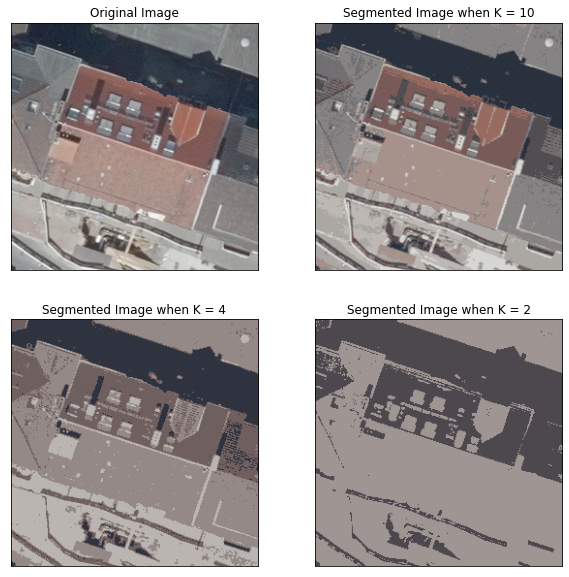

In [72]:
figure_size = 10
plt.figure(figsize=(figure_size,figure_size))

#original image
plt.subplot(2,2,1),plt.imshow(img)
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

#image 1
plt.subplot(2,2,2),plt.imshow(result_image1)
plt.title('Segmented Image when K = 10'), plt.xticks([]), plt.yticks([])

#image 2
plt.subplot(2,2,3),plt.imshow(result_image2)
plt.title('Segmented Image when K = 4'), plt.xticks([]), plt.yticks([])

#image 3
plt.subplot(2,2,4),plt.imshow(result_image3)
plt.title('Segmented Image when K = 2'), plt.xticks([]), plt.yticks([])
plt.show()

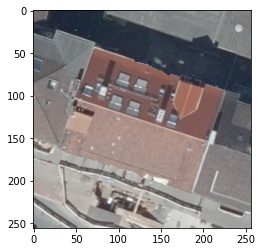

In [55]:
plt.imshow(img)


5f460df6-712f-402b-bbe9-99cf70ab2358


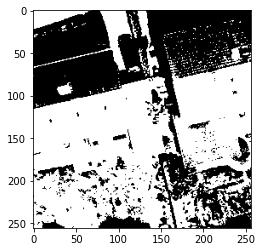

78f79906-dad1-4d9d-8ca2-0b7d9f844912


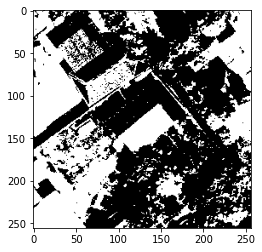

5c7a376b-9fc4-4caf-89bd-73fdde04e6b7


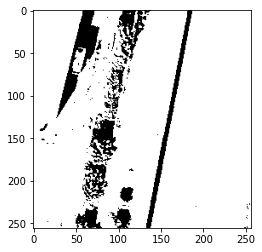

9aaecd16-09a0-47e6-b98a-2f06ea4b4065


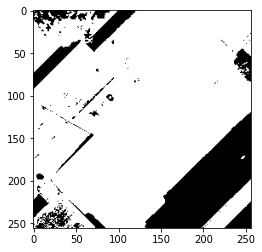

84e643fc-9eaf-4fd6-ae88-7d8f8efe0820


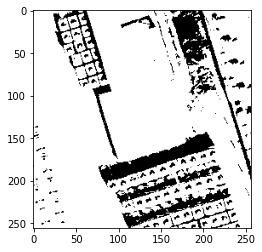

5a49a41f-9f6f-4efc-9ef7-9ddb9a7601c6


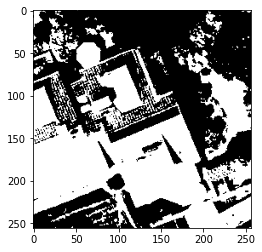

3d0bb70d-99ca-402f-bb15-a3ed99587242


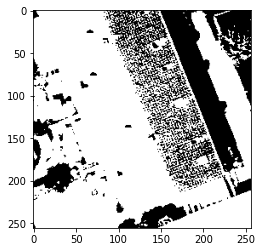

6d935815-3f99-4f7b-a5fd-1dbfeb901676


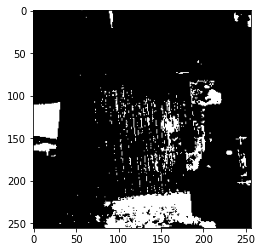

8e8329ce-7e5e-4490-ace3-46a533482dca


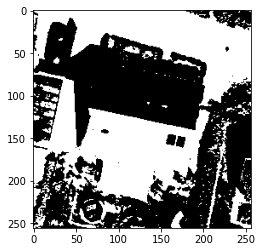

5c149348-a684-4476-8aec-3c499fb74345


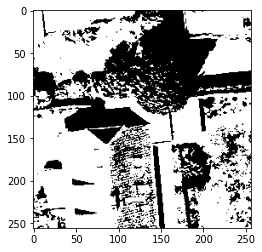

5dcde43e-70c3-4235-8252-2e2d79220562


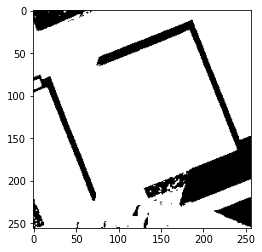

In [73]:
# segmentation based on grey-scale
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
import math

from PIL import Image
import glob
image_list = []

for i,filename in enumerate(glob.glob('drive/MyDrive/data/*.PNG')):
    if i > 10 : break
    print(filename.split("/")[-1].split(".")[0])
    # mask = masks[filename.split("/")[-1].split(".")[0]] #'img'
    img = mpimg.imread(filename) #'img/'+
    gray = 0.2989 * img[:, :, 0] + 0.5870 * img[:, :, 1] + 0.1140 * img[:, :, 2]
    binary = np.zeros(gray.shape)
    threshold = 0.42
    for i in range(gray.shape[0]):
      for j in range(gray.shape[1]):
        if gray[i, j] > threshold:
          binary[i, j] = 1
    plt.imshow(binary, cmap='gray')
    plt.show()

In [ ]:
#!rm -rf logs

In [ ]:
#!kill 3877

/bin/bash: line 0: kill: (3877) - No such process
